<a href="https://colab.research.google.com/github/frnocentini/a-star-js/blob/master/ResNet101V2_1exp.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'


/content/drive/MyDrive/dataset brain tumor/dataset


In [3]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [4]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [5]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [6]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, Dense, Activation
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import ResNet101V2
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils

In [7]:
%cd '/dataset unzipped'

/dataset unzipped


In [8]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    # Convert the image to grayscale, and blur it slightl
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()
    
    return new_image,extLeft,extRight,extTop,extBot

In [9]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 224

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_train.append(image)

image_index = 0
#bb_train = np.zeros((len(X_train),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)

                #print(temp_array)
                #bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
#bb_test = np.zeros((len(X_test),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

                #bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))

#print(bb_test[30])
#print(extRight_coords_x_test[30])
#print(extLeft_coords_x_test[30])

Dimensione delle liste prima di duplicare le immagini:
X_train:  878
bb_list:  878
Dimensione delle liste dopo la duplicazione delle immagini:
X_train:  919
bb_train:  919
Dimensione delle liste prima di duplicare le immagini:
X_test:  223
bb_list:  223
Dimensione delle liste dopo la duplicazione delle immagini:
X_test:  237
bb_test:  237


In [10]:
len(X_train)

919

In [11]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [12]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [13]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [14]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [15]:
BATCH_SIZE = 16
#save_path = os.path.join('./', 'model_effnet')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test, batch_size = BATCH_SIZE)

In [16]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)

def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou



In [17]:
#def iou(y_true,y_pred):
  #pred_bbox_val = model.predict(X_val)
  #iou = tf.numpy_function(calculate_iou,[y_true,y_pred],tf.float32)
  #return iou

In [18]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, width, height = bbox_coords
        img = cv2.rectangle(img, (int(xmin-width/2), int(ymin-height/2)), (int(xmin+width/2), int(ymin+height/2)), (255, 0, 0), 1)
        #img = cv2.rectangle(img, (0,0),(10,10), (0, 0, 255), 1)
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, width1, height1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-width1/2), int(ymin1-height1/2)), (int(xmin1+width1/2), int(ymin1+height1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [19]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [20]:
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_RESNET

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_RESNET’: File exists


In [21]:
save_path = './model_checkpoint_RESNET/model_RESNET.h5'

In [22]:
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    filepath=save_path,
    monitor="val_IoU",
    verbose=1,
    mode="max",
    save_best_only=True
    ),
    tf.keras.callbacks.EarlyStopping(
    monitor="val_IoU",
    patience=20,
    verbose=0,
    mode="max",
    restore_best_weights=True,
    start_from_epoch=50,
),

    ShowTestImages()
]

In [47]:
resnet = ResNet101V2(weights='imagenet',include_top=False,input_shape=(image_size,image_size,3))
model = resnet.output
model = tf.keras.layers.GlobalAveragePooling2D()(model)
model = tf.keras.layers.Dropout(rate=0.5)(model)
model = layers.Dense(256)(model)
model = tf.keras.layers.Dropout(rate=0.5)(model)
model = tf.keras.layers.Dense(4,name='bb_pred')(model)
model = tf.keras.models.Model(inputs=resnet.input, outputs = model)
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_2[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                            

In [24]:
model.compile(
    loss={
        'bb_pred': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
    
)

Epoch 1/100
52/52 [==============================] - ETA: 0s - loss: 35.0103 - IoU: 0.0572
Epoch 1: val_IoU improved from -inf to 0.00000, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 141ms/step


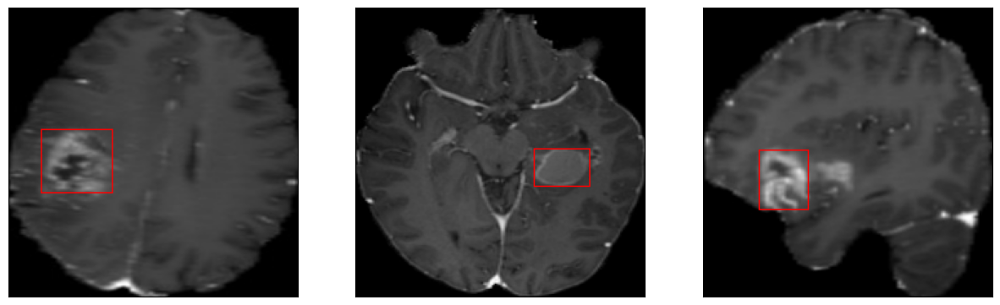

52/52 [==============================] - 126s 928ms/step - loss: 35.0103 - IoU: 0.0572 - val_loss: 430237.5312 - val_IoU: 0.0000e+00
Epoch 2/100
52/52 [==============================] - ETA: 0s - loss: 25.0402 - IoU: 0.1121
Epoch 2: val_IoU improved from 0.00000 to 0.04053, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 142ms/step


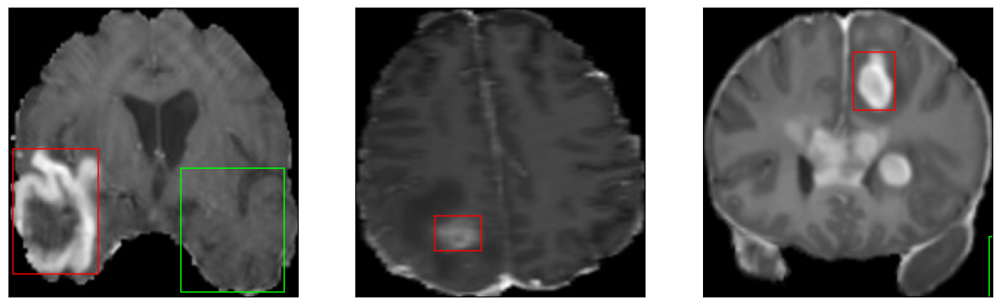

52/52 [==============================] - 31s 599ms/step - loss: 25.0402 - IoU: 0.1121 - val_loss: 89.3583 - val_IoU: 0.0405
Epoch 3/100
52/52 [==============================] - ETA: 0s - loss: 19.1964 - IoU: 0.2129
Epoch 3: val_IoU did not improve from 0.04053
8/8 [==============================] - 1s 145ms/step


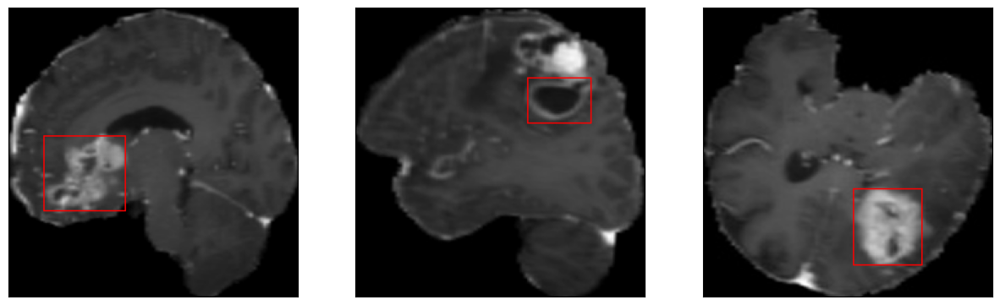

52/52 [==============================] - 19s 368ms/step - loss: 19.1964 - IoU: 0.2129 - val_loss: 99.1685 - val_IoU: 0.0062
Epoch 4/100
52/52 [==============================] - ETA: 0s - loss: 18.1768 - IoU: 0.2424
Epoch 4: val_IoU did not improve from 0.04053
8/8 [==============================] - 1s 141ms/step


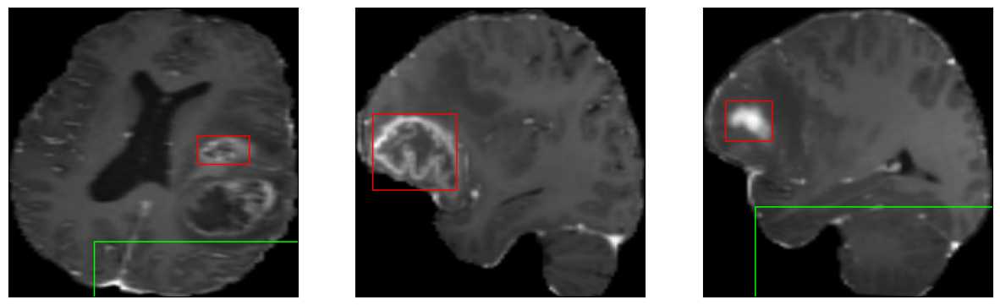

52/52 [==============================] - 19s 368ms/step - loss: 18.1768 - IoU: 0.2424 - val_loss: 211.9431 - val_IoU: 0.0031
Epoch 5/100
52/52 [==============================] - ETA: 0s - loss: 17.0145 - IoU: 0.2490
Epoch 5: val_IoU improved from 0.04053 to 0.07795, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 139ms/step


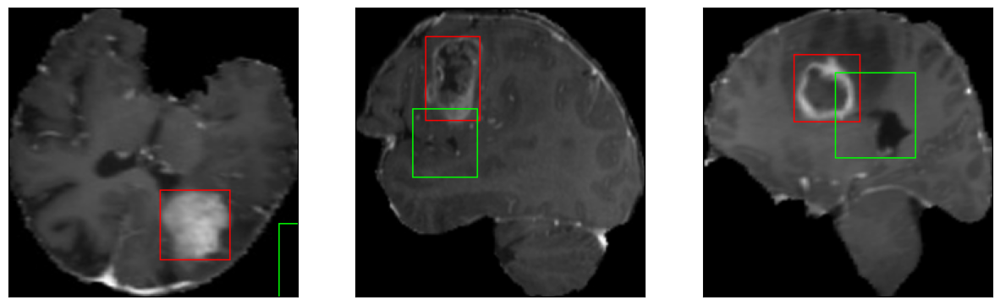

52/52 [==============================] - 35s 682ms/step - loss: 17.0145 - IoU: 0.2490 - val_loss: 41.4029 - val_IoU: 0.0779
Epoch 6/100
52/52 [==============================] - ETA: 0s - loss: 15.1844 - IoU: 0.2944
Epoch 6: val_IoU improved from 0.07795 to 0.15769, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 139ms/step


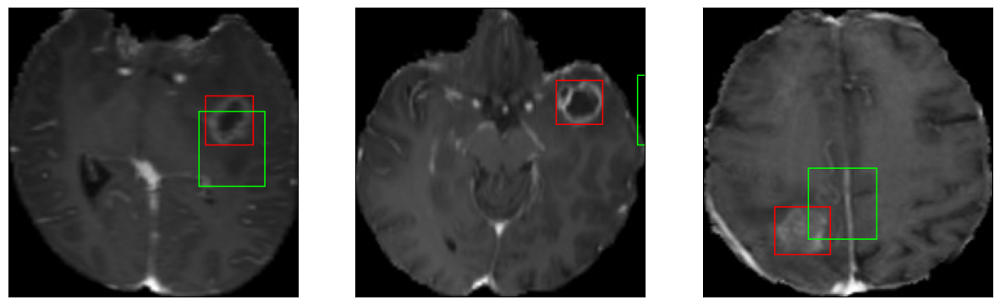

52/52 [==============================] - 32s 625ms/step - loss: 15.1844 - IoU: 0.2944 - val_loss: 27.5166 - val_IoU: 0.1577
Epoch 7/100
52/52 [==============================] - ETA: 0s - loss: 14.9212 - IoU: 0.3020
Epoch 7: val_IoU improved from 0.15769 to 0.17290, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 143ms/step


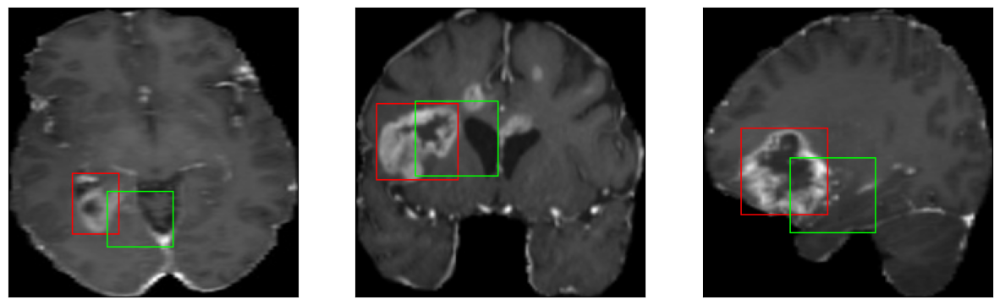

52/52 [==============================] - 23s 447ms/step - loss: 14.9212 - IoU: 0.3020 - val_loss: 21.8679 - val_IoU: 0.1729
Epoch 8/100
52/52 [==============================] - ETA: 0s - loss: 14.1645 - IoU: 0.3153
Epoch 8: val_IoU improved from 0.17290 to 0.40402, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 141ms/step


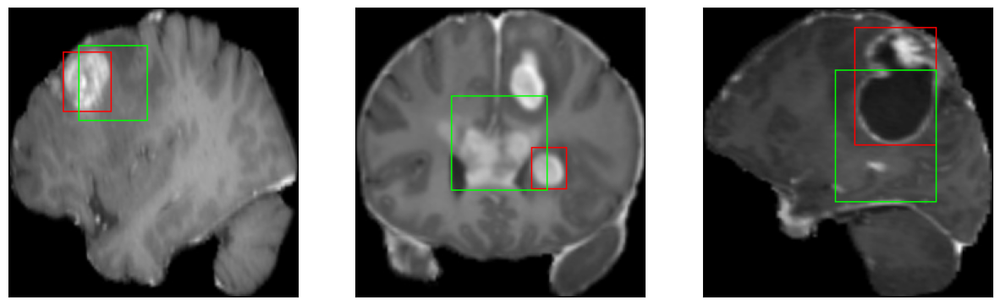

52/52 [==============================] - 35s 682ms/step - loss: 14.1645 - IoU: 0.3153 - val_loss: 16.0846 - val_IoU: 0.4040
Epoch 9/100
52/52 [==============================] - ETA: 0s - loss: 13.3442 - IoU: 0.3351
Epoch 9: val_IoU did not improve from 0.40402
8/8 [==============================] - 1s 146ms/step


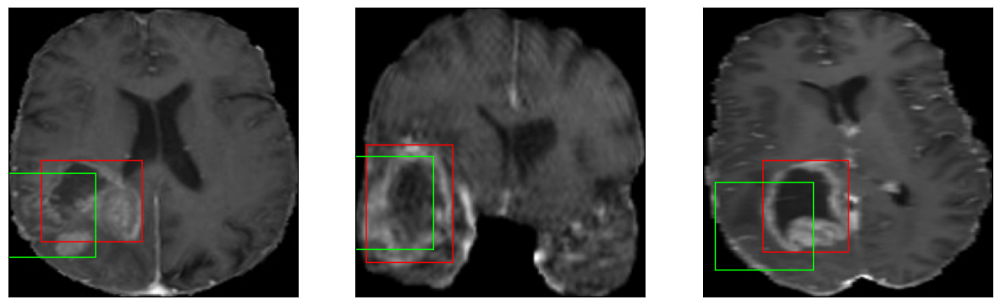

52/52 [==============================] - 20s 377ms/step - loss: 13.3442 - IoU: 0.3351 - val_loss: 21.4554 - val_IoU: 0.2273
Epoch 10/100
52/52 [==============================] - ETA: 0s - loss: 13.0437 - IoU: 0.3354
Epoch 10: val_IoU did not improve from 0.40402
8/8 [==============================] - 1s 142ms/step


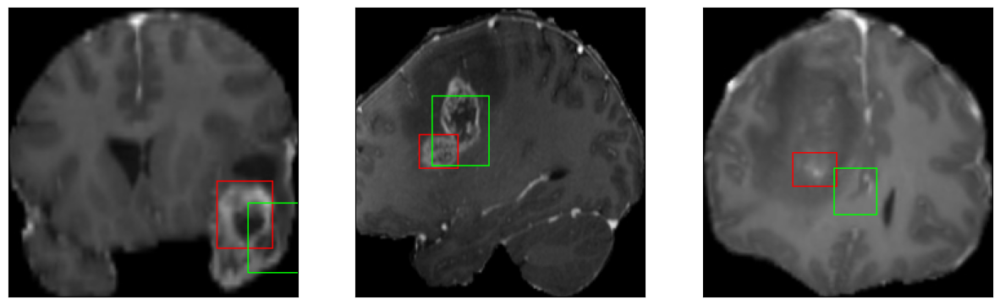

52/52 [==============================] - 19s 373ms/step - loss: 13.0437 - IoU: 0.3354 - val_loss: 19.5519 - val_IoU: 0.2108
Epoch 11/100
52/52 [==============================] - ETA: 0s - loss: 12.6608 - IoU: 0.3471
Epoch 11: val_IoU improved from 0.40402 to 0.40709, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 139ms/step


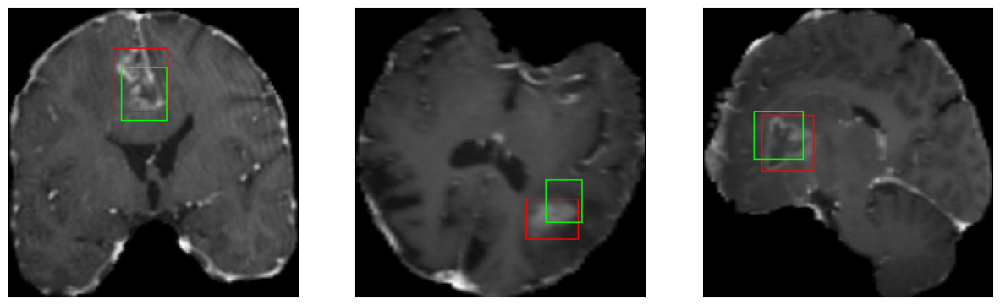

52/52 [==============================] - 35s 675ms/step - loss: 12.6608 - IoU: 0.3471 - val_loss: 13.5908 - val_IoU: 0.4071
Epoch 12/100
52/52 [==============================] - ETA: 0s - loss: 12.2608 - IoU: 0.3542
Epoch 12: val_IoU improved from 0.40709 to 0.43477, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 142ms/step


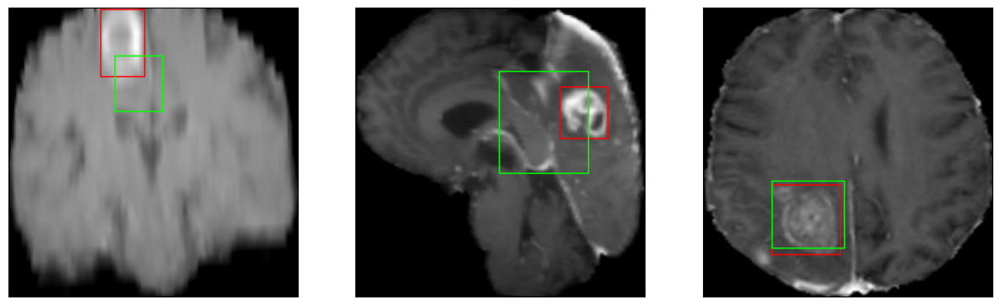

52/52 [==============================] - 36s 701ms/step - loss: 12.2608 - IoU: 0.3542 - val_loss: 12.9016 - val_IoU: 0.4348
Epoch 13/100
52/52 [==============================] - ETA: 0s - loss: 12.2635 - IoU: 0.3608
Epoch 13: val_IoU improved from 0.43477 to 0.43637, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 140ms/step


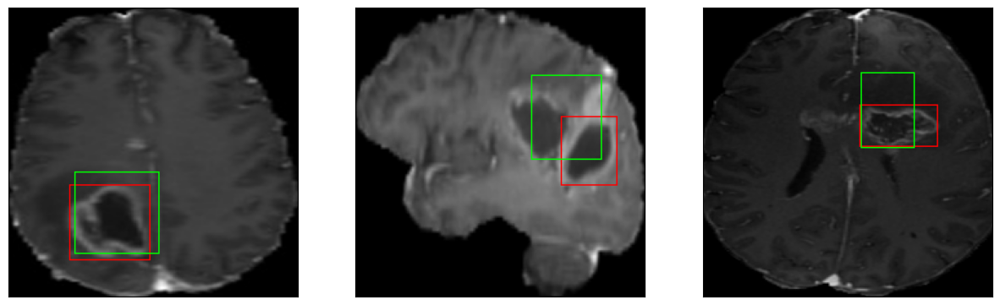

52/52 [==============================] - 36s 705ms/step - loss: 12.2635 - IoU: 0.3608 - val_loss: 12.3007 - val_IoU: 0.4364
Epoch 14/100
52/52 [==============================] - ETA: 0s - loss: 12.2540 - IoU: 0.3582
Epoch 14: val_IoU did not improve from 0.43637
8/8 [==============================] - 1s 141ms/step


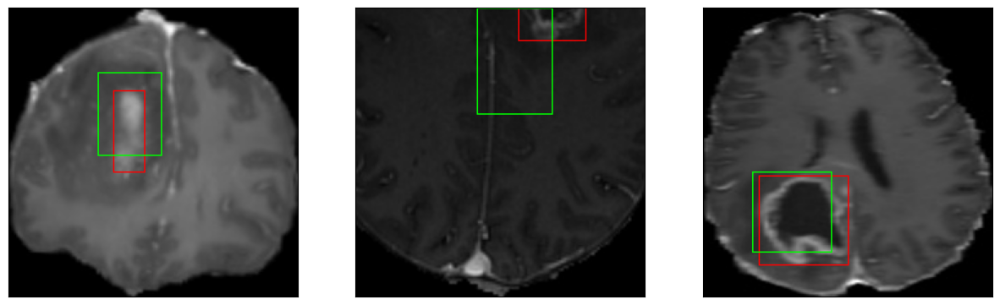

52/52 [==============================] - 19s 372ms/step - loss: 12.2540 - IoU: 0.3582 - val_loss: 14.0366 - val_IoU: 0.4142
Epoch 15/100
52/52 [==============================] - ETA: 0s - loss: 11.8870 - IoU: 0.3743
Epoch 15: val_IoU improved from 0.43637 to 0.47334, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 139ms/step


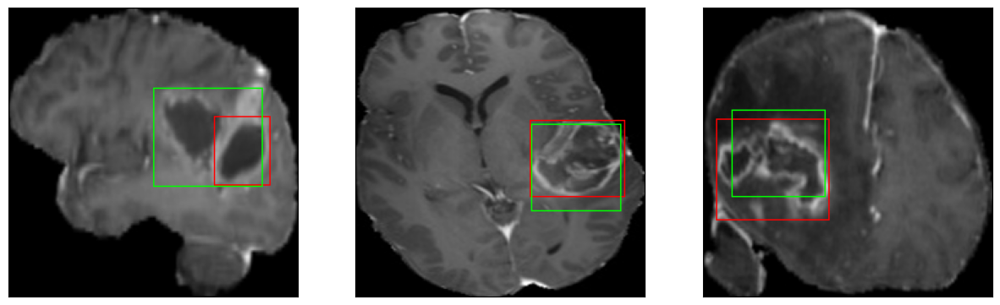

52/52 [==============================] - 36s 695ms/step - loss: 11.8870 - IoU: 0.3743 - val_loss: 12.9857 - val_IoU: 0.4733
Epoch 16/100
52/52 [==============================] - ETA: 0s - loss: 11.2632 - IoU: 0.3841
Epoch 16: val_IoU did not improve from 0.47334
8/8 [==============================] - 1s 141ms/step


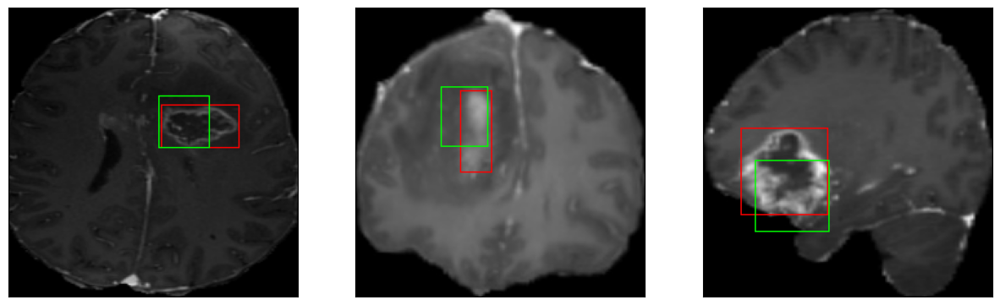

52/52 [==============================] - 19s 371ms/step - loss: 11.2632 - IoU: 0.3841 - val_loss: 14.4949 - val_IoU: 0.3745
Epoch 17/100
52/52 [==============================] - ETA: 0s - loss: 11.1137 - IoU: 0.3989
Epoch 17: val_IoU did not improve from 0.47334
8/8 [==============================] - 1s 143ms/step


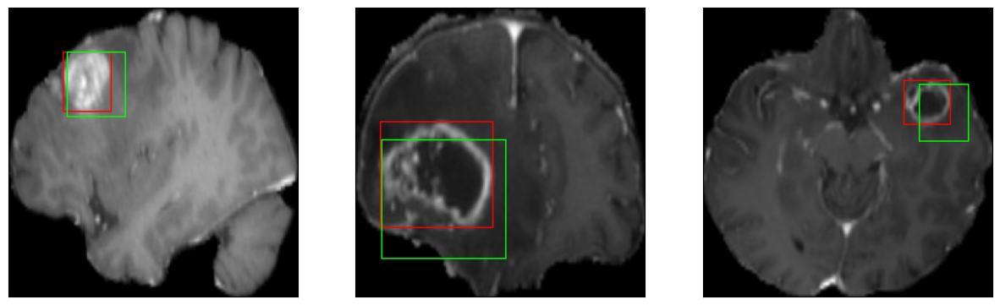

52/52 [==============================] - 20s 380ms/step - loss: 11.1137 - IoU: 0.3989 - val_loss: 13.1097 - val_IoU: 0.4152
Epoch 18/100
52/52 [==============================] - ETA: 0s - loss: 11.2831 - IoU: 0.3781
Epoch 18: val_IoU did not improve from 0.47334
8/8 [==============================] - 1s 141ms/step


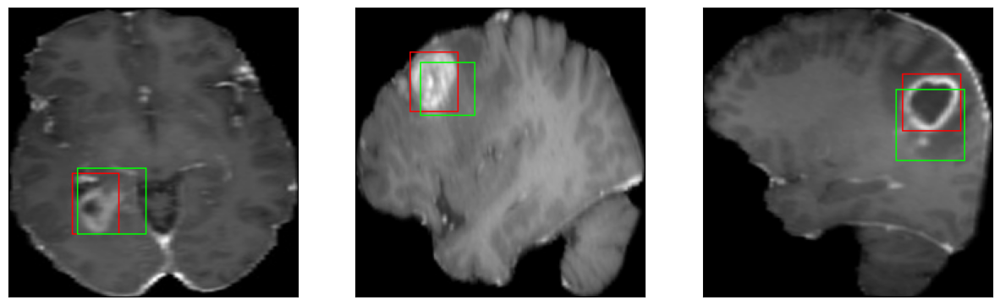

52/52 [==============================] - 20s 378ms/step - loss: 11.2831 - IoU: 0.3781 - val_loss: 12.3742 - val_IoU: 0.4256
Epoch 19/100
52/52 [==============================] - ETA: 0s - loss: 10.6498 - IoU: 0.3999
Epoch 19: val_IoU did not improve from 0.47334
8/8 [==============================] - 1s 143ms/step


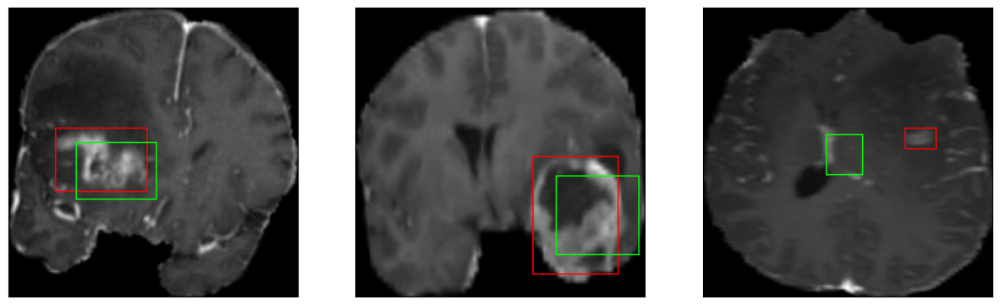

52/52 [==============================] - 19s 367ms/step - loss: 10.6498 - IoU: 0.3999 - val_loss: 14.5861 - val_IoU: 0.3013
Epoch 20/100
52/52 [==============================] - ETA: 0s - loss: 10.6465 - IoU: 0.4121
Epoch 20: val_IoU did not improve from 0.47334
8/8 [==============================] - 1s 142ms/step


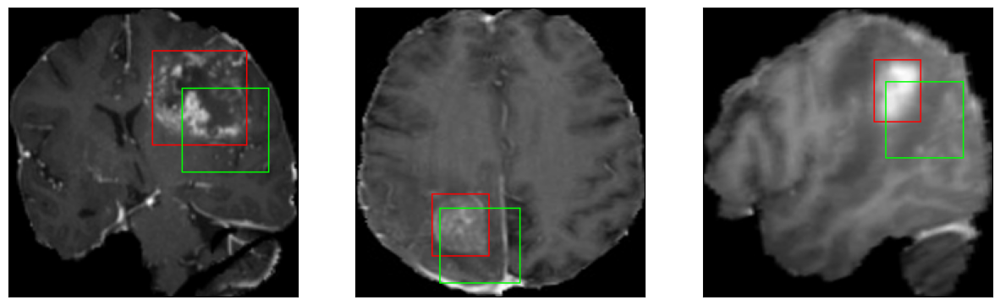

52/52 [==============================] - 19s 364ms/step - loss: 10.6465 - IoU: 0.4121 - val_loss: 19.1877 - val_IoU: 0.2949
Epoch 21/100
52/52 [==============================] - ETA: 0s - loss: 10.8390 - IoU: 0.4069
Epoch 21: val_IoU did not improve from 0.47334
8/8 [==============================] - 1s 143ms/step


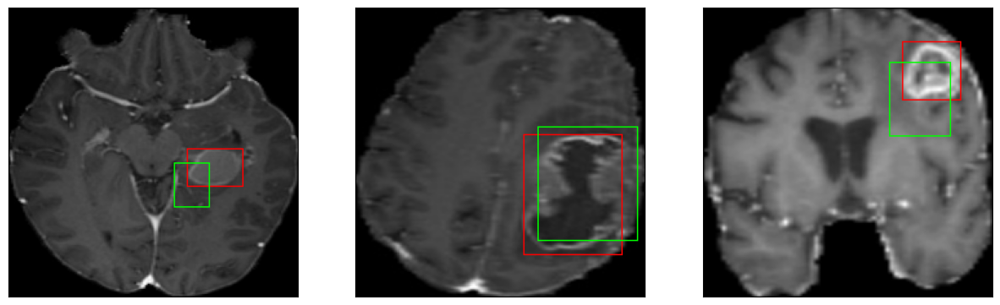

52/52 [==============================] - 19s 368ms/step - loss: 10.8390 - IoU: 0.4069 - val_loss: 13.2493 - val_IoU: 0.4023
Epoch 22/100
52/52 [==============================] - ETA: 0s - loss: 10.5789 - IoU: 0.4020
Epoch 22: val_IoU improved from 0.47334 to 0.49301, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 140ms/step


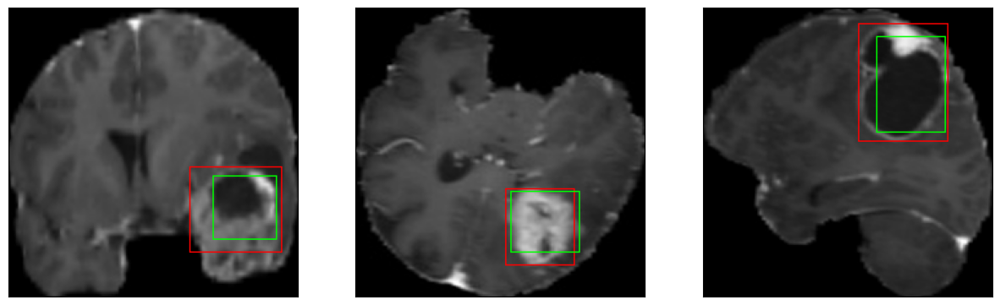

52/52 [==============================] - 36s 696ms/step - loss: 10.5789 - IoU: 0.4020 - val_loss: 10.9049 - val_IoU: 0.4930
Epoch 23/100
52/52 [==============================] - ETA: 0s - loss: 10.3217 - IoU: 0.4148
Epoch 23: val_IoU did not improve from 0.49301
8/8 [==============================] - 1s 142ms/step


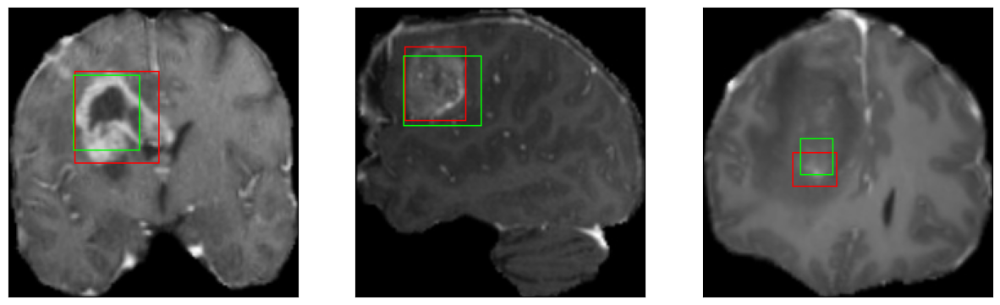

52/52 [==============================] - 20s 381ms/step - loss: 10.3217 - IoU: 0.4148 - val_loss: 10.1131 - val_IoU: 0.4889
Epoch 24/100
52/52 [==============================] - ETA: 0s - loss: 10.5702 - IoU: 0.3996
Epoch 24: val_IoU did not improve from 0.49301
8/8 [==============================] - 1s 143ms/step


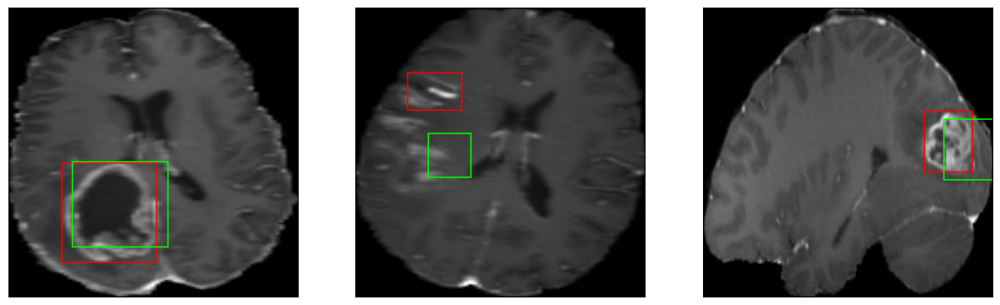

52/52 [==============================] - 19s 370ms/step - loss: 10.5702 - IoU: 0.3996 - val_loss: 13.3330 - val_IoU: 0.3713
Epoch 25/100
52/52 [==============================] - ETA: 0s - loss: 11.0605 - IoU: 0.3920
Epoch 25: val_IoU did not improve from 0.49301
8/8 [==============================] - 1s 142ms/step


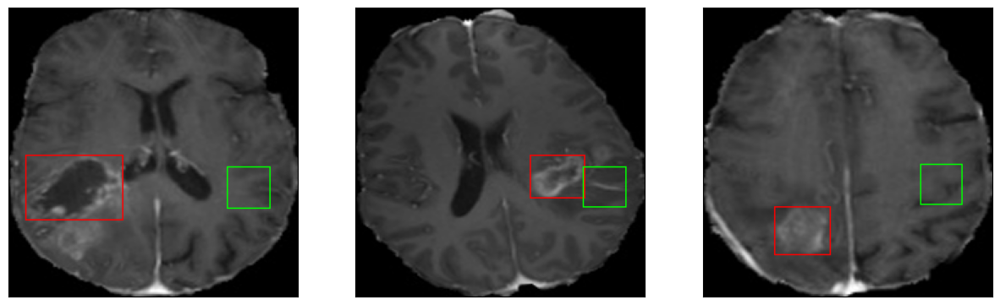

52/52 [==============================] - 19s 368ms/step - loss: 11.0605 - IoU: 0.3920 - val_loss: 32.2229 - val_IoU: 0.0792
Epoch 26/100
52/52 [==============================] - ETA: 0s - loss: 10.2173 - IoU: 0.4269
Epoch 26: val_IoU improved from 0.49301 to 0.52887, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 139ms/step


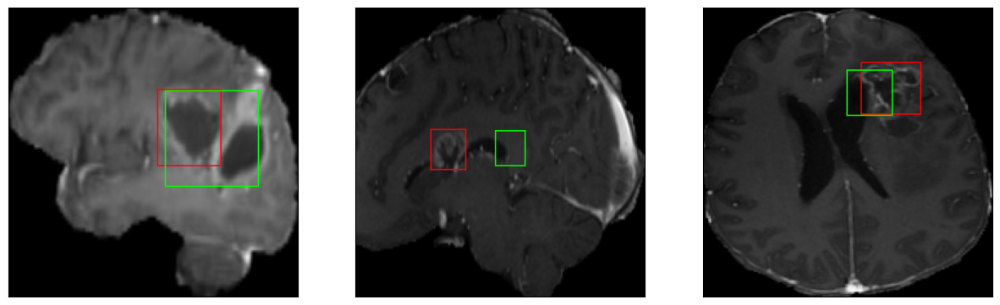

52/52 [==============================] - 29s 553ms/step - loss: 10.2173 - IoU: 0.4269 - val_loss: 9.9766 - val_IoU: 0.5289
Epoch 27/100
52/52 [==============================] - ETA: 0s - loss: 10.3900 - IoU: 0.3996
Epoch 27: val_IoU did not improve from 0.52887
8/8 [==============================] - 1s 141ms/step


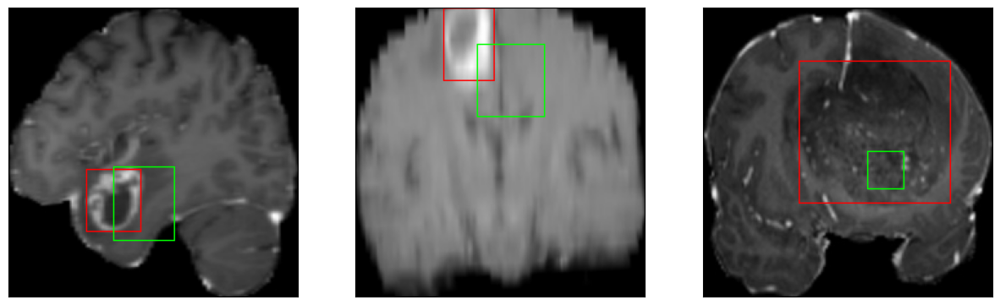

52/52 [==============================] - 19s 364ms/step - loss: 10.3900 - IoU: 0.3996 - val_loss: 14.4128 - val_IoU: 0.3022
Epoch 28/100
52/52 [==============================] - ETA: 0s - loss: 10.2264 - IoU: 0.4202
Epoch 28: val_IoU did not improve from 0.52887
8/8 [==============================] - 1s 144ms/step


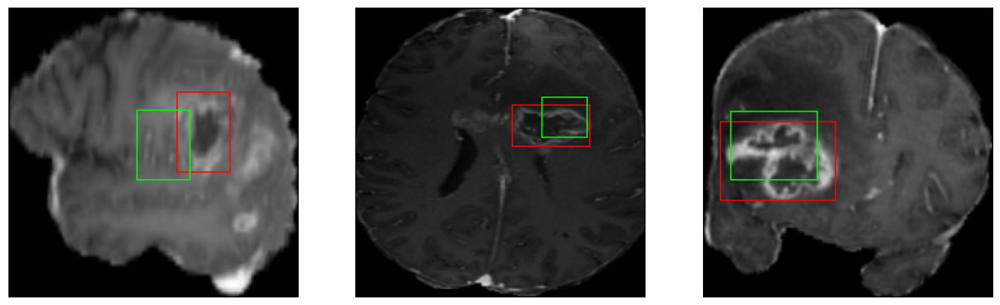

52/52 [==============================] - 19s 376ms/step - loss: 10.2264 - IoU: 0.4202 - val_loss: 12.2943 - val_IoU: 0.4109
Epoch 29/100
52/52 [==============================] - ETA: 0s - loss: 10.4444 - IoU: 0.4123
Epoch 29: val_IoU did not improve from 0.52887
8/8 [==============================] - 1s 140ms/step


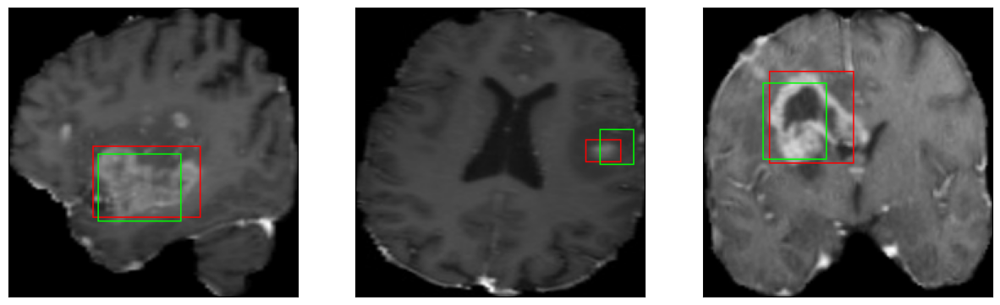

52/52 [==============================] - 19s 370ms/step - loss: 10.4444 - IoU: 0.4123 - val_loss: 10.1419 - val_IoU: 0.5086
Epoch 30/100
52/52 [==============================] - ETA: 0s - loss: 9.7100 - IoU: 0.4227
Epoch 30: val_IoU did not improve from 0.52887
8/8 [==============================] - 1s 142ms/step


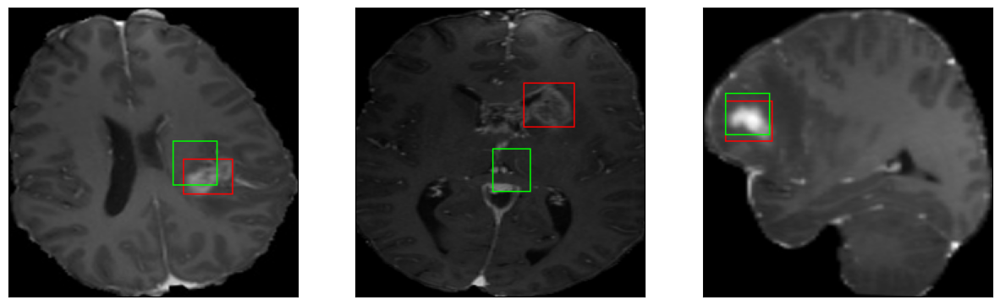

52/52 [==============================] - 19s 367ms/step - loss: 9.7100 - IoU: 0.4227 - val_loss: 10.2752 - val_IoU: 0.4612
Epoch 31/100
52/52 [==============================] - ETA: 0s - loss: 10.3471 - IoU: 0.4175
Epoch 31: val_IoU did not improve from 0.52887
8/8 [==============================] - 1s 139ms/step


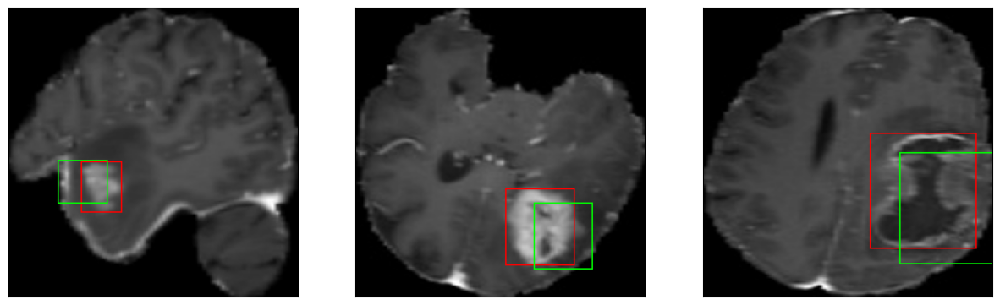

52/52 [==============================] - 19s 372ms/step - loss: 10.3471 - IoU: 0.4175 - val_loss: 14.8167 - val_IoU: 0.3543
Epoch 32/100
52/52 [==============================] - ETA: 0s - loss: 9.8989 - IoU: 0.4258
Epoch 32: val_IoU did not improve from 0.52887
8/8 [==============================] - 1s 142ms/step


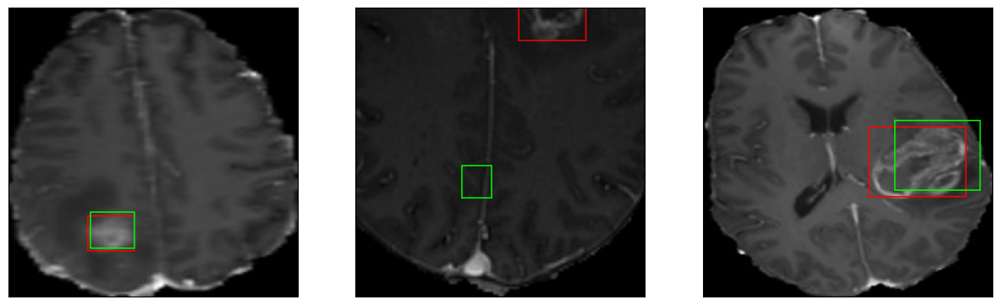

52/52 [==============================] - 19s 368ms/step - loss: 9.8989 - IoU: 0.4258 - val_loss: 10.6427 - val_IoU: 0.5079
Epoch 33/100
52/52 [==============================] - ETA: 0s - loss: 9.6822 - IoU: 0.4220
Epoch 33: val_IoU improved from 0.52887 to 0.53470, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 142ms/step


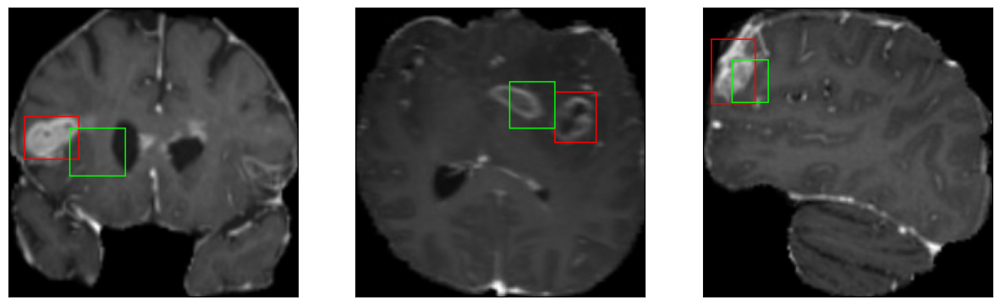

52/52 [==============================] - 31s 604ms/step - loss: 9.6822 - IoU: 0.4220 - val_loss: 9.3366 - val_IoU: 0.5347
Epoch 34/100
52/52 [==============================] - ETA: 0s - loss: 9.6920 - IoU: 0.4309
Epoch 34: val_IoU did not improve from 0.53470
8/8 [==============================] - 1s 142ms/step


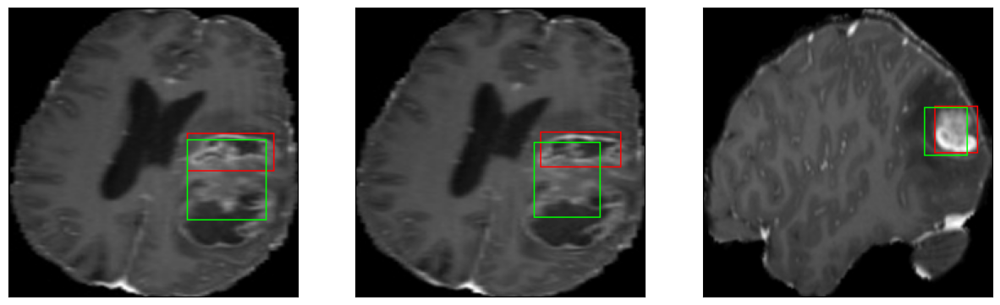

52/52 [==============================] - 20s 376ms/step - loss: 9.6920 - IoU: 0.4309 - val_loss: 10.6654 - val_IoU: 0.4644
Epoch 35/100
52/52 [==============================] - ETA: 0s - loss: 10.1368 - IoU: 0.4169
Epoch 35: val_IoU did not improve from 0.53470
8/8 [==============================] - 1s 141ms/step


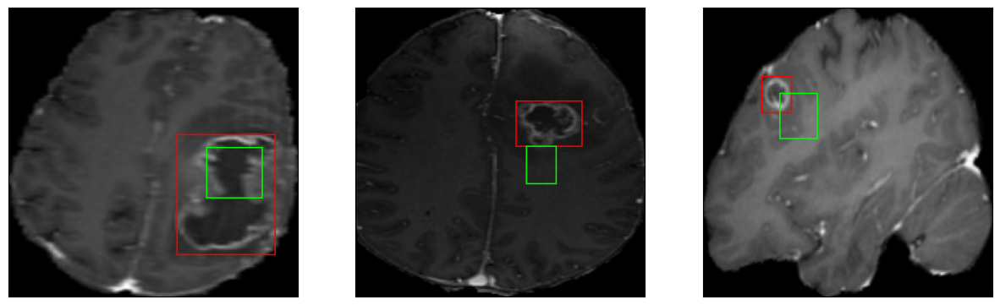

52/52 [==============================] - 19s 373ms/step - loss: 10.1368 - IoU: 0.4169 - val_loss: 12.9114 - val_IoU: 0.3962
Epoch 36/100
52/52 [==============================] - ETA: 0s - loss: 9.5046 - IoU: 0.4348
Epoch 36: val_IoU did not improve from 0.53470
8/8 [==============================] - 1s 140ms/step


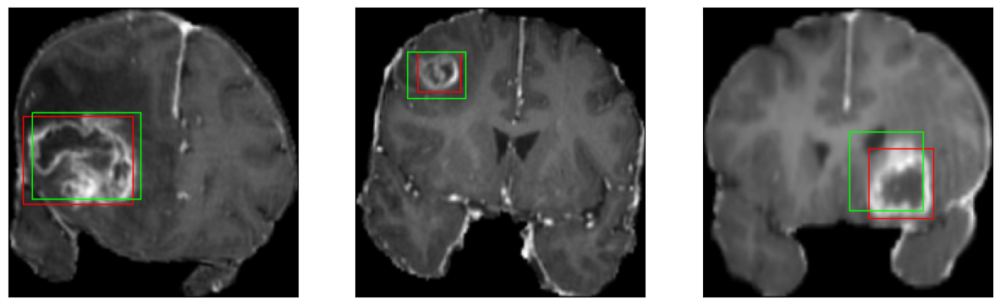

52/52 [==============================] - 19s 375ms/step - loss: 9.5046 - IoU: 0.4348 - val_loss: 10.6776 - val_IoU: 0.4956
Epoch 37/100
52/52 [==============================] - ETA: 0s - loss: 9.6456 - IoU: 0.4303
Epoch 37: val_IoU did not improve from 0.53470
8/8 [==============================] - 1s 140ms/step


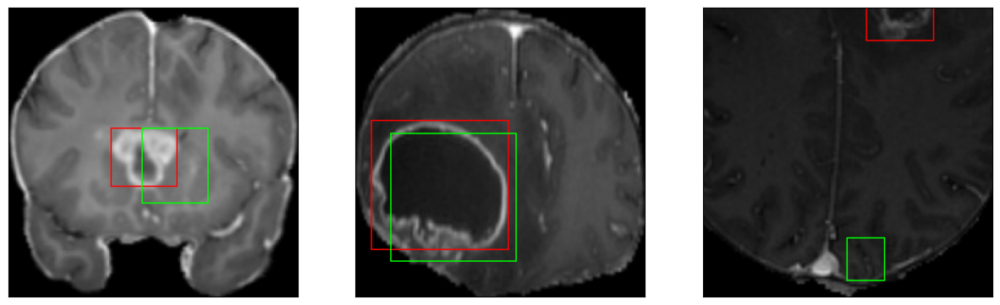

52/52 [==============================] - 19s 364ms/step - loss: 9.6456 - IoU: 0.4303 - val_loss: 11.8942 - val_IoU: 0.3879
Epoch 38/100
52/52 [==============================] - ETA: 0s - loss: 9.5025 - IoU: 0.4346
Epoch 38: val_IoU did not improve from 0.53470
8/8 [==============================] - 1s 142ms/step


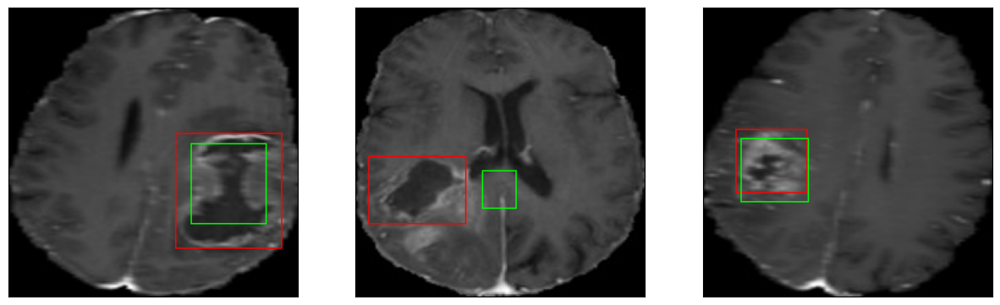

52/52 [==============================] - 20s 377ms/step - loss: 9.5025 - IoU: 0.4346 - val_loss: 9.6294 - val_IoU: 0.5323
Epoch 39/100
52/52 [==============================] - ETA: 0s - loss: 9.6302 - IoU: 0.4242
Epoch 39: val_IoU did not improve from 0.53470
8/8 [==============================] - 1s 140ms/step


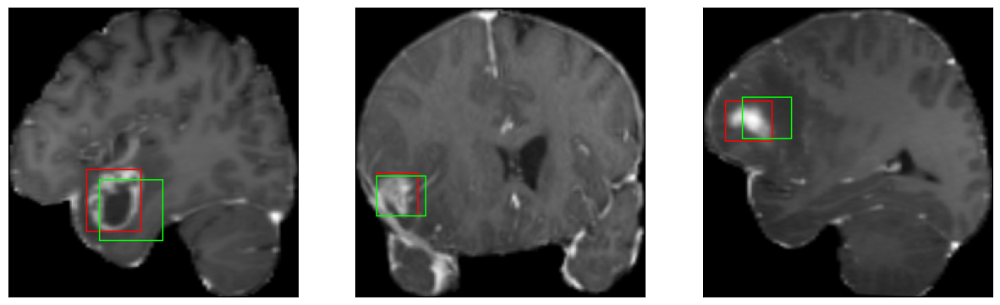

52/52 [==============================] - 19s 367ms/step - loss: 9.6302 - IoU: 0.4242 - val_loss: 10.5635 - val_IoU: 0.4780
Epoch 40/100
52/52 [==============================] - ETA: 0s - loss: 9.2521 - IoU: 0.4334
Epoch 40: val_IoU did not improve from 0.53470
8/8 [==============================] - 1s 141ms/step


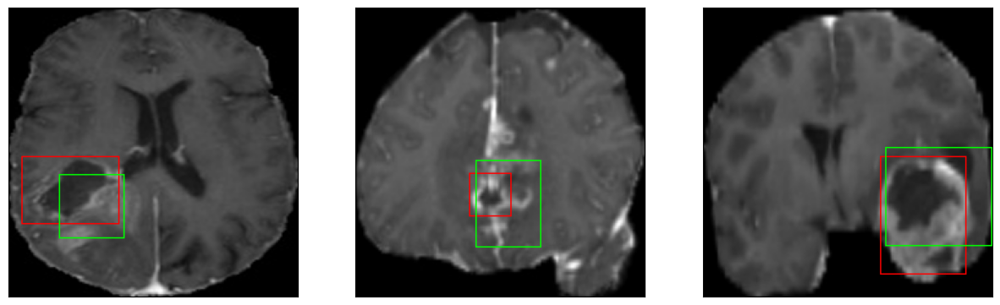

52/52 [==============================] - 19s 362ms/step - loss: 9.2521 - IoU: 0.4334 - val_loss: 11.1483 - val_IoU: 0.4823
Epoch 41/100
52/52 [==============================] - ETA: 0s - loss: 9.9603 - IoU: 0.4159
Epoch 41: val_IoU did not improve from 0.53470
8/8 [==============================] - 1s 141ms/step


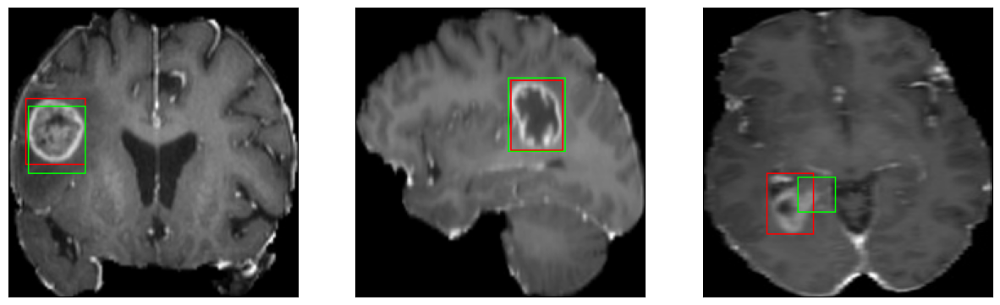

52/52 [==============================] - 19s 372ms/step - loss: 9.9603 - IoU: 0.4159 - val_loss: 10.4525 - val_IoU: 0.5275
Epoch 42/100
52/52 [==============================] - ETA: 0s - loss: 9.5861 - IoU: 0.4314
Epoch 42: val_IoU did not improve from 0.53470
8/8 [==============================] - 1s 140ms/step


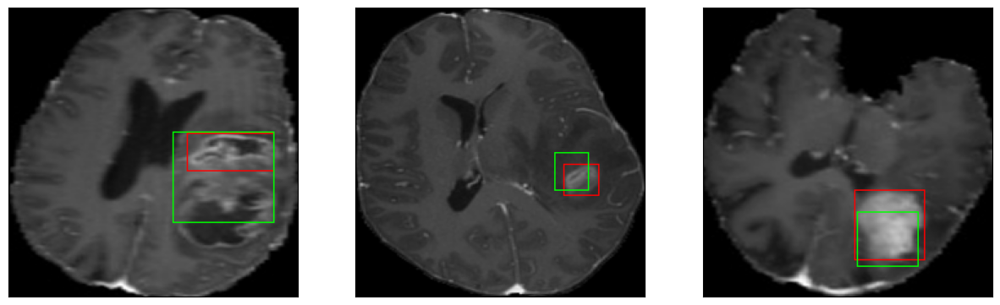

52/52 [==============================] - 19s 371ms/step - loss: 9.5861 - IoU: 0.4314 - val_loss: 11.1489 - val_IoU: 0.5159
Epoch 43/100
52/52 [==============================] - ETA: 0s - loss: 9.4221 - IoU: 0.4289
Epoch 43: val_IoU did not improve from 0.53470
8/8 [==============================] - 1s 142ms/step


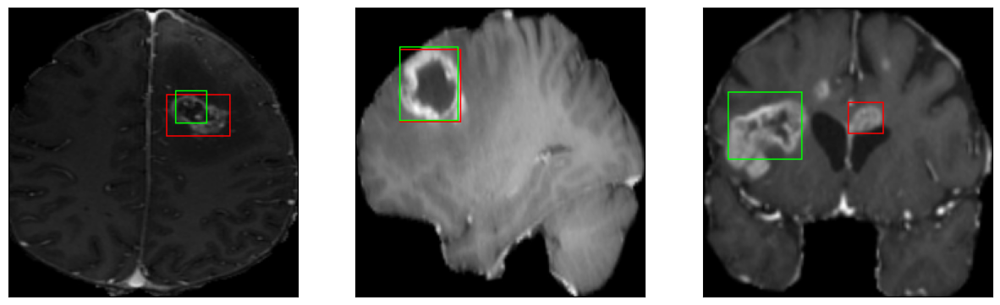

52/52 [==============================] - 20s 379ms/step - loss: 9.4221 - IoU: 0.4289 - val_loss: 10.9469 - val_IoU: 0.4415
Epoch 44/100
52/52 [==============================] - ETA: 0s - loss: 9.4864 - IoU: 0.4294
Epoch 44: val_IoU improved from 0.53470 to 0.55538, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 140ms/step


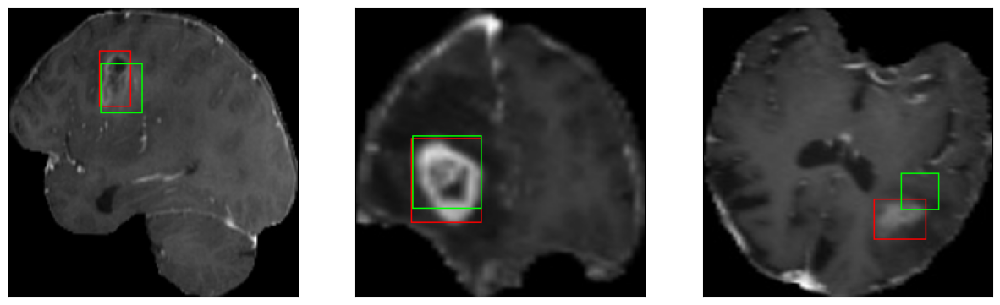

52/52 [==============================] - 36s 691ms/step - loss: 9.4864 - IoU: 0.4294 - val_loss: 9.5237 - val_IoU: 0.5554
Epoch 45/100
52/52 [==============================] - ETA: 0s - loss: 9.6390 - IoU: 0.4301
Epoch 45: val_IoU did not improve from 0.55538
8/8 [==============================] - 1s 144ms/step


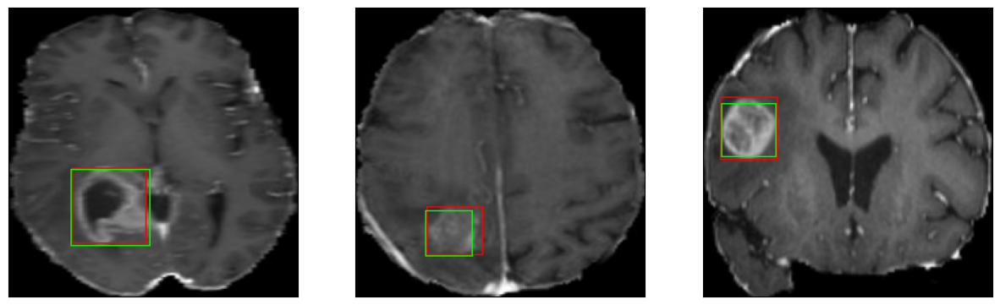

52/52 [==============================] - 19s 376ms/step - loss: 9.6390 - IoU: 0.4301 - val_loss: 10.1616 - val_IoU: 0.5335
Epoch 46/100
52/52 [==============================] - ETA: 0s - loss: 9.2150 - IoU: 0.4480
Epoch 46: val_IoU did not improve from 0.55538
8/8 [==============================] - 1s 143ms/step


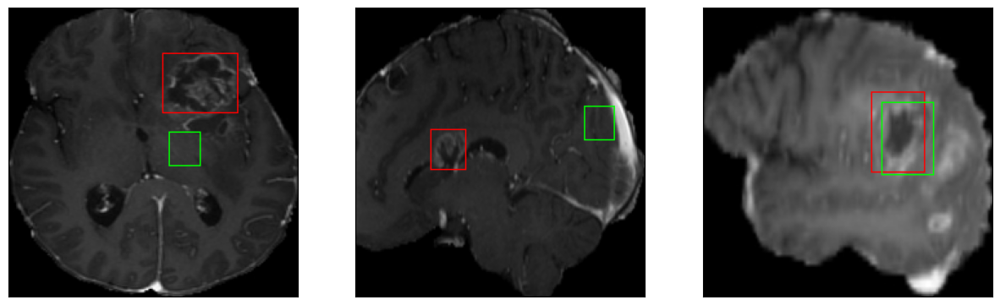

52/52 [==============================] - 19s 374ms/step - loss: 9.2150 - IoU: 0.4480 - val_loss: 9.9929 - val_IoU: 0.5425
Epoch 47/100
52/52 [==============================] - ETA: 0s - loss: 9.2929 - IoU: 0.4330
Epoch 47: val_IoU did not improve from 0.55538
8/8 [==============================] - 1s 140ms/step


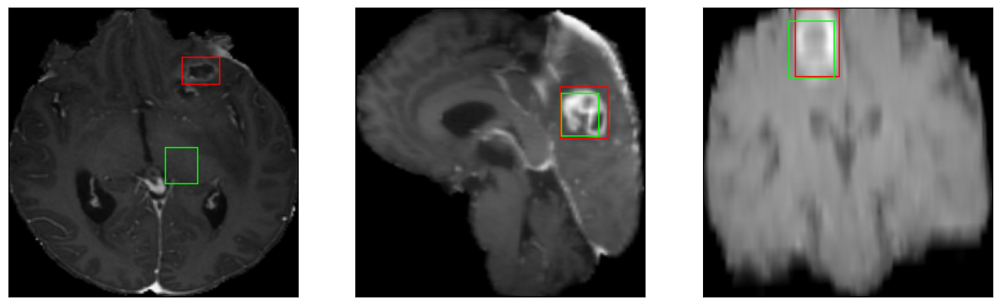

52/52 [==============================] - 20s 382ms/step - loss: 9.2929 - IoU: 0.4330 - val_loss: 9.9198 - val_IoU: 0.5320
Epoch 48/100
52/52 [==============================] - ETA: 0s - loss: 8.7894 - IoU: 0.4557
Epoch 48: val_IoU improved from 0.55538 to 0.55923, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 140ms/step


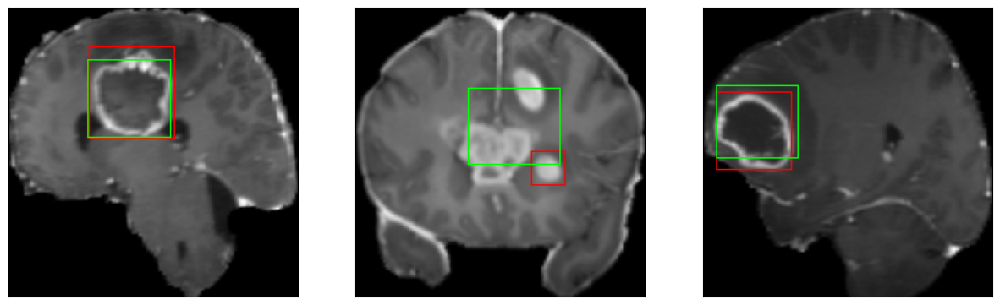

52/52 [==============================] - 35s 687ms/step - loss: 8.7894 - IoU: 0.4557 - val_loss: 9.6395 - val_IoU: 0.5592
Epoch 49/100
52/52 [==============================] - ETA: 0s - loss: 9.4054 - IoU: 0.4389
Epoch 49: val_IoU did not improve from 0.55923
8/8 [==============================] - 1s 141ms/step


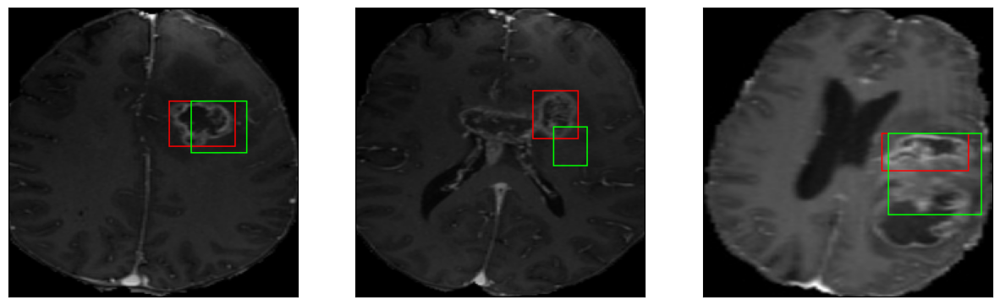

52/52 [==============================] - 19s 373ms/step - loss: 9.4054 - IoU: 0.4389 - val_loss: 11.0038 - val_IoU: 0.4565
Epoch 50/100
52/52 [==============================] - ETA: 0s - loss: 9.1979 - IoU: 0.4406
Epoch 50: val_IoU did not improve from 0.55923
8/8 [==============================] - 1s 144ms/step


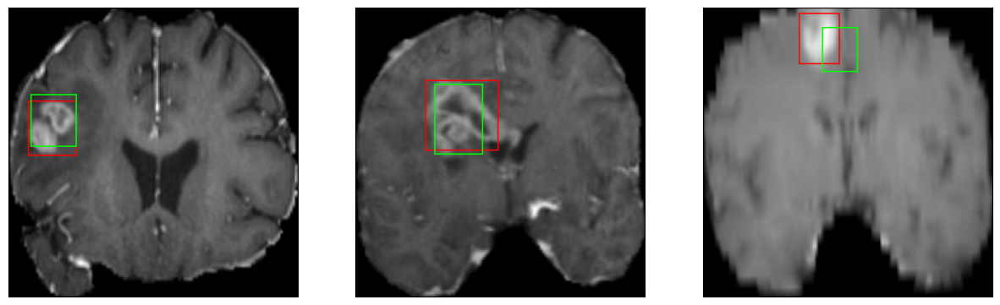

52/52 [==============================] - 19s 377ms/step - loss: 9.1979 - IoU: 0.4406 - val_loss: 9.8365 - val_IoU: 0.5479
Epoch 51/100
52/52 [==============================] - ETA: 0s - loss: 9.6333 - IoU: 0.4235
Epoch 51: val_IoU did not improve from 0.55923
8/8 [==============================] - 1s 141ms/step


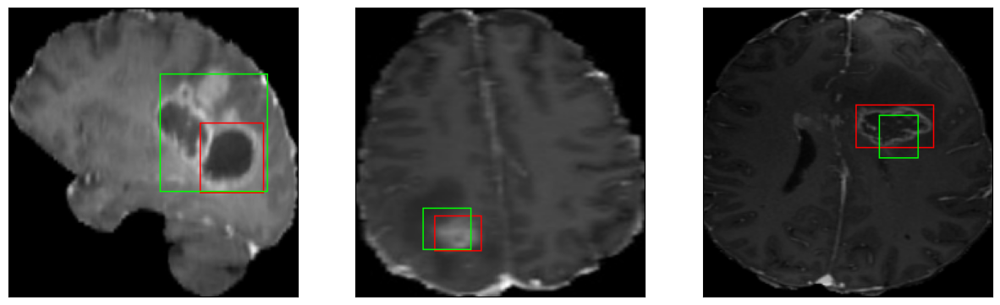

52/52 [==============================] - 20s 380ms/step - loss: 9.6333 - IoU: 0.4235 - val_loss: 11.2179 - val_IoU: 0.5203
Epoch 52/100
52/52 [==============================] - ETA: 0s - loss: 9.5826 - IoU: 0.4319
Epoch 52: val_IoU did not improve from 0.55923
8/8 [==============================] - 1s 142ms/step


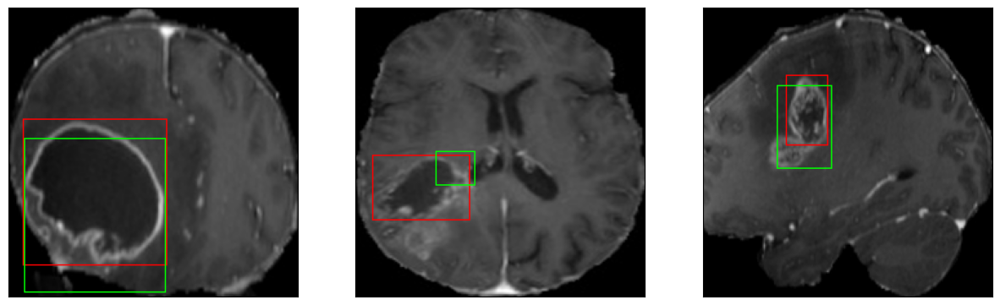

52/52 [==============================] - 19s 376ms/step - loss: 9.5826 - IoU: 0.4319 - val_loss: 10.0338 - val_IoU: 0.4972
Epoch 53/100
52/52 [==============================] - ETA: 0s - loss: 9.4416 - IoU: 0.4280
Epoch 53: val_IoU did not improve from 0.55923
8/8 [==============================] - 1s 142ms/step


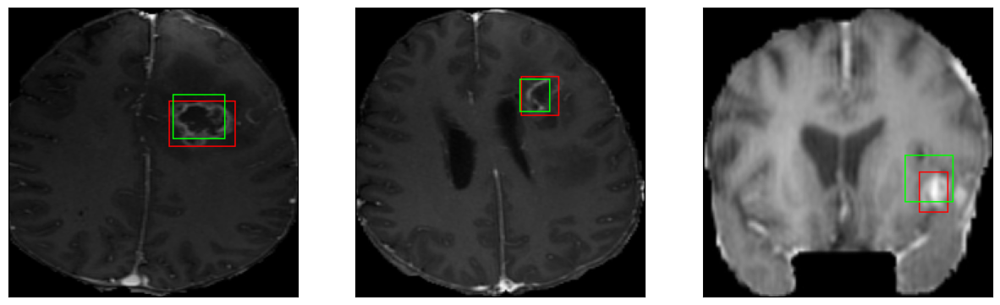

52/52 [==============================] - 20s 378ms/step - loss: 9.4416 - IoU: 0.4280 - val_loss: 10.1573 - val_IoU: 0.5202
Epoch 54/100
52/52 [==============================] - ETA: 0s - loss: 9.2920 - IoU: 0.4329
Epoch 54: val_IoU did not improve from 0.55923
8/8 [==============================] - 1s 141ms/step


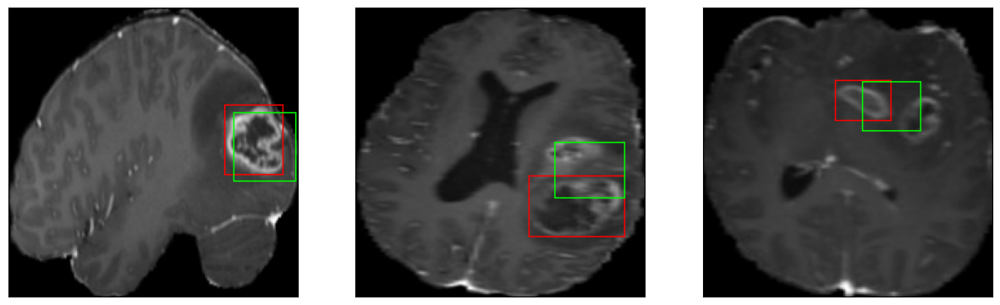

52/52 [==============================] - 19s 374ms/step - loss: 9.2920 - IoU: 0.4329 - val_loss: 10.2974 - val_IoU: 0.5338
Epoch 55/100
52/52 [==============================] - ETA: 0s - loss: 9.1656 - IoU: 0.4403
Epoch 55: val_IoU did not improve from 0.55923
8/8 [==============================] - 1s 143ms/step


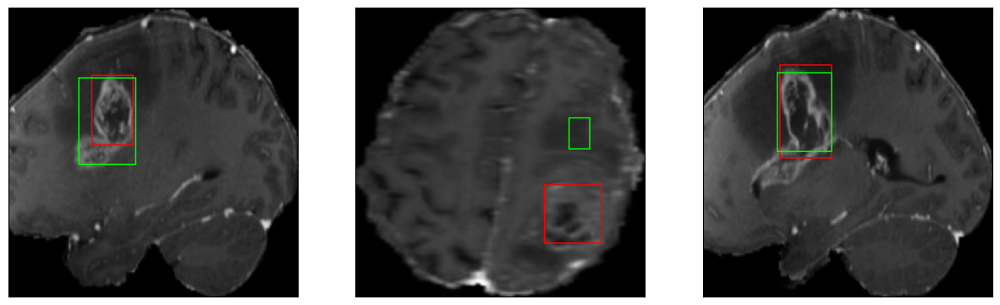

52/52 [==============================] - 20s 378ms/step - loss: 9.1656 - IoU: 0.4403 - val_loss: 9.6689 - val_IoU: 0.5488
Epoch 56/100
52/52 [==============================] - ETA: 0s - loss: 9.3221 - IoU: 0.4397
Epoch 56: val_IoU improved from 0.55923 to 0.57904, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 140ms/step


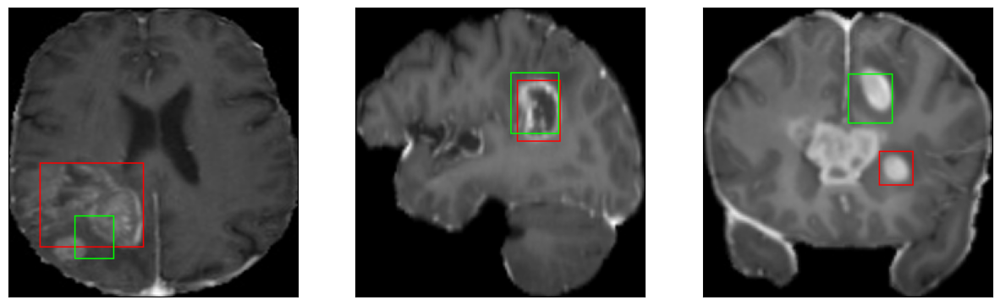

52/52 [==============================] - 35s 671ms/step - loss: 9.3221 - IoU: 0.4397 - val_loss: 9.0066 - val_IoU: 0.5790
Epoch 57/100
52/52 [==============================] - ETA: 0s - loss: 9.8458 - IoU: 0.4183
Epoch 57: val_IoU did not improve from 0.57904
8/8 [==============================] - 1s 142ms/step


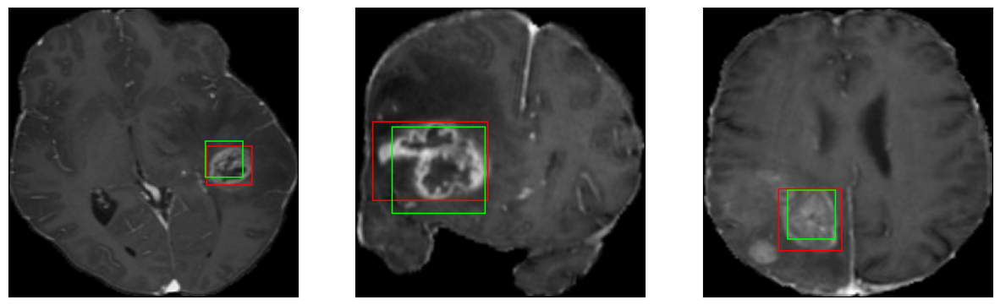

52/52 [==============================] - 19s 370ms/step - loss: 9.8458 - IoU: 0.4183 - val_loss: 10.5475 - val_IoU: 0.5310
Epoch 58/100
52/52 [==============================] - ETA: 0s - loss: 9.4511 - IoU: 0.4293
Epoch 58: val_IoU did not improve from 0.57904
8/8 [==============================] - 1s 143ms/step


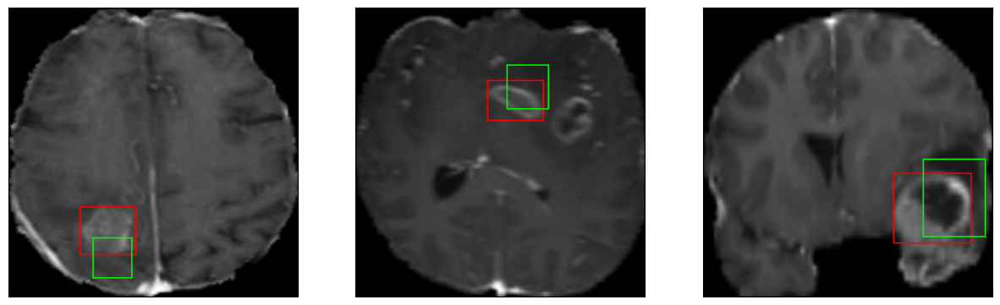

52/52 [==============================] - 19s 375ms/step - loss: 9.4511 - IoU: 0.4293 - val_loss: 12.6043 - val_IoU: 0.5012
Epoch 59/100
52/52 [==============================] - ETA: 0s - loss: 9.3124 - IoU: 0.4459
Epoch 59: val_IoU did not improve from 0.57904
8/8 [==============================] - 1s 141ms/step


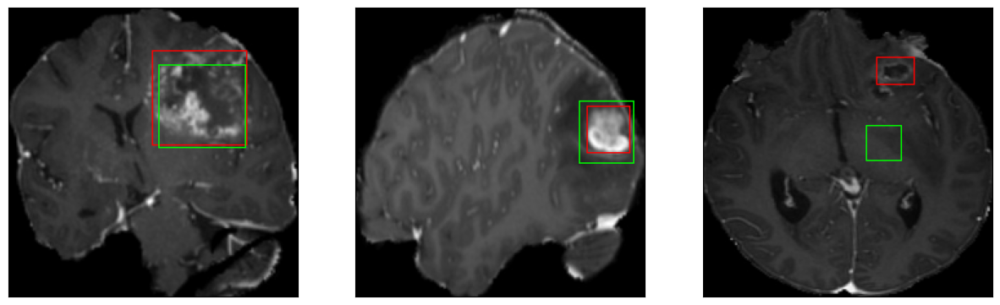

52/52 [==============================] - 19s 369ms/step - loss: 9.3124 - IoU: 0.4459 - val_loss: 17.2489 - val_IoU: 0.4488
Epoch 60/100
52/52 [==============================] - ETA: 0s - loss: 9.3925 - IoU: 0.4333
Epoch 60: val_IoU did not improve from 0.57904
8/8 [==============================] - 1s 141ms/step


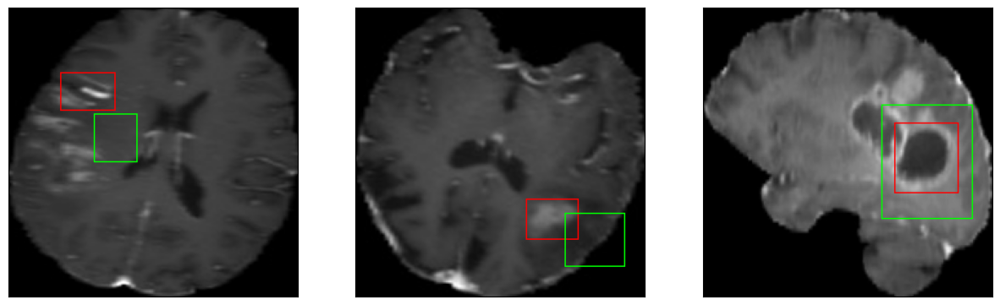

52/52 [==============================] - 19s 371ms/step - loss: 9.3925 - IoU: 0.4333 - val_loss: 16.3746 - val_IoU: 0.2235
Epoch 61/100
52/52 [==============================] - ETA: 0s - loss: 9.1659 - IoU: 0.4440
Epoch 61: val_IoU did not improve from 0.57904
8/8 [==============================] - 1s 142ms/step


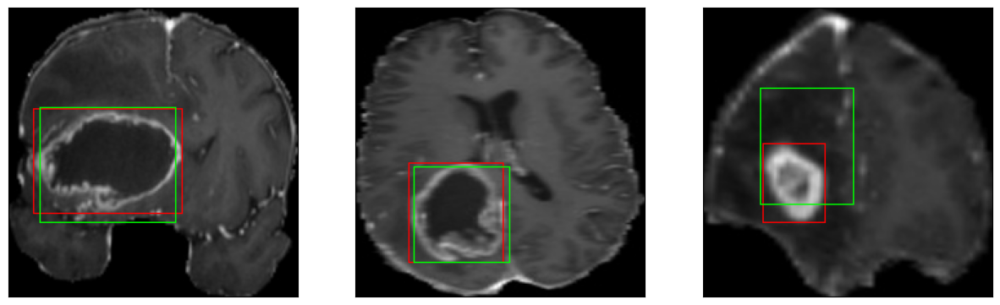

52/52 [==============================] - 19s 371ms/step - loss: 9.1659 - IoU: 0.4440 - val_loss: 10.7425 - val_IoU: 0.5027
Epoch 62/100
52/52 [==============================] - ETA: 0s - loss: 9.3092 - IoU: 0.4344
Epoch 62: val_IoU improved from 0.57904 to 0.59856, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 141ms/step


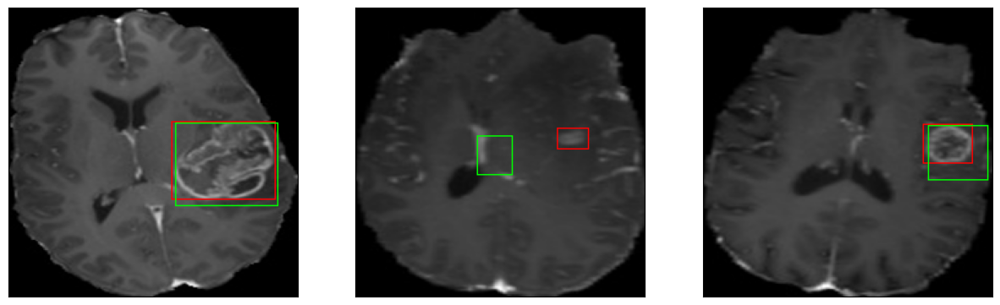

52/52 [==============================] - 35s 688ms/step - loss: 9.3092 - IoU: 0.4344 - val_loss: 8.4293 - val_IoU: 0.5986
Epoch 63/100
52/52 [==============================] - ETA: 0s - loss: 9.1525 - IoU: 0.4467
Epoch 63: val_IoU did not improve from 0.59856
8/8 [==============================] - 1s 144ms/step


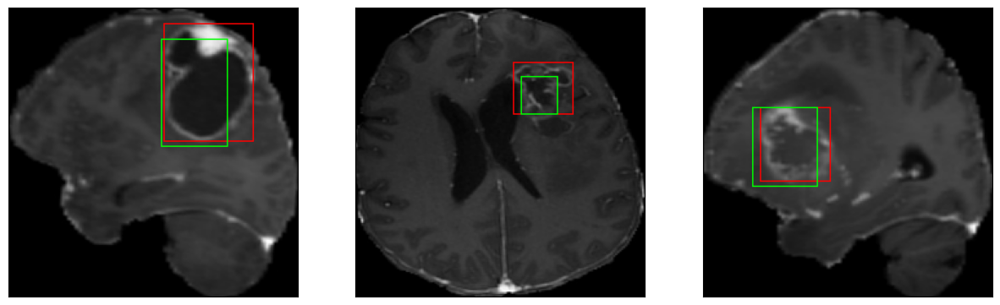

52/52 [==============================] - 20s 376ms/step - loss: 9.1525 - IoU: 0.4467 - val_loss: 9.8126 - val_IoU: 0.5275
Epoch 64/100
52/52 [==============================] - ETA: 0s - loss: 8.9167 - IoU: 0.4469
Epoch 64: val_IoU did not improve from 0.59856
8/8 [==============================] - 1s 142ms/step


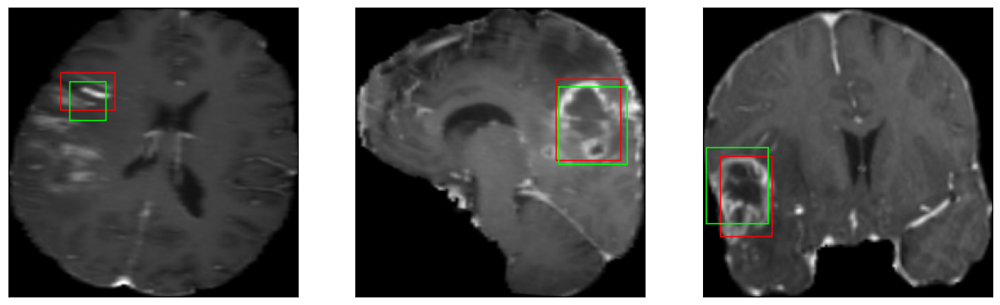

52/52 [==============================] - 19s 368ms/step - loss: 8.9167 - IoU: 0.4469 - val_loss: 10.0840 - val_IoU: 0.5438
Epoch 65/100
52/52 [==============================] - ETA: 0s - loss: 8.8218 - IoU: 0.4499
Epoch 65: val_IoU did not improve from 0.59856
8/8 [==============================] - 1s 141ms/step


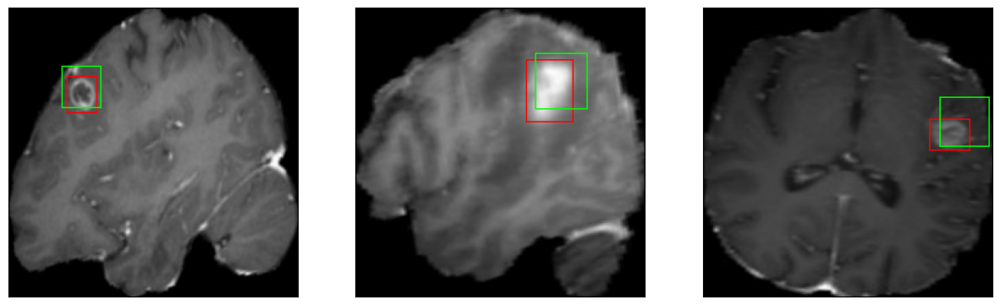

52/52 [==============================] - 19s 376ms/step - loss: 8.8218 - IoU: 0.4499 - val_loss: 10.6735 - val_IoU: 0.4794
Epoch 66/100
52/52 [==============================] - ETA: 0s - loss: 8.9066 - IoU: 0.4444
Epoch 66: val_IoU did not improve from 0.59856
8/8 [==============================] - 1s 142ms/step


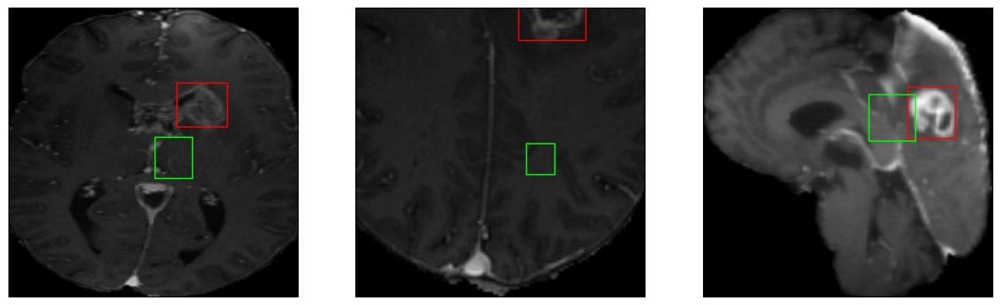

52/52 [==============================] - 19s 371ms/step - loss: 8.9066 - IoU: 0.4444 - val_loss: 9.9142 - val_IoU: 0.5535
Epoch 67/100
52/52 [==============================] - ETA: 0s - loss: 9.0749 - IoU: 0.4399
Epoch 67: val_IoU did not improve from 0.59856
8/8 [==============================] - 1s 142ms/step


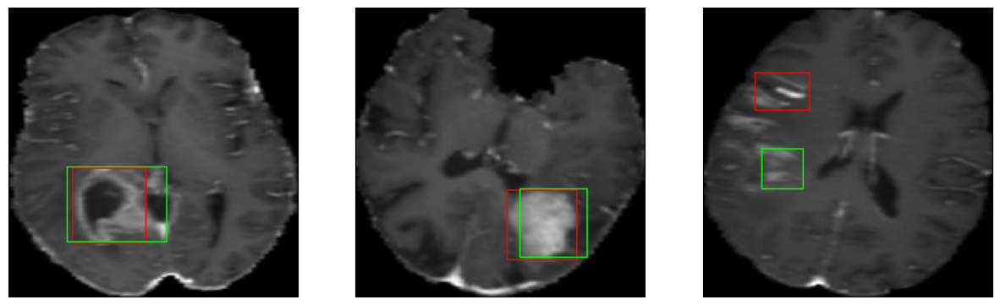

52/52 [==============================] - 19s 371ms/step - loss: 9.0749 - IoU: 0.4399 - val_loss: 11.2646 - val_IoU: 0.5377
Epoch 68/100
52/52 [==============================] - ETA: 0s - loss: 8.6823 - IoU: 0.4547
Epoch 68: val_IoU did not improve from 0.59856
8/8 [==============================] - 1s 142ms/step


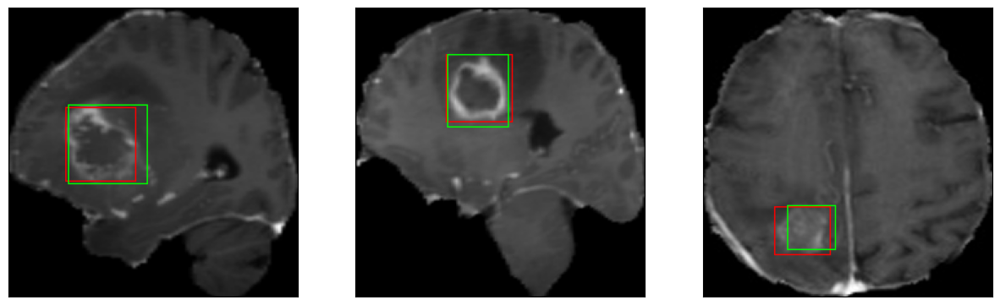

52/52 [==============================] - 20s 377ms/step - loss: 8.6823 - IoU: 0.4547 - val_loss: 10.1186 - val_IoU: 0.5283
Epoch 69/100
52/52 [==============================] - ETA: 0s - loss: 8.7937 - IoU: 0.4485
Epoch 69: val_IoU did not improve from 0.59856
8/8 [==============================] - 1s 142ms/step


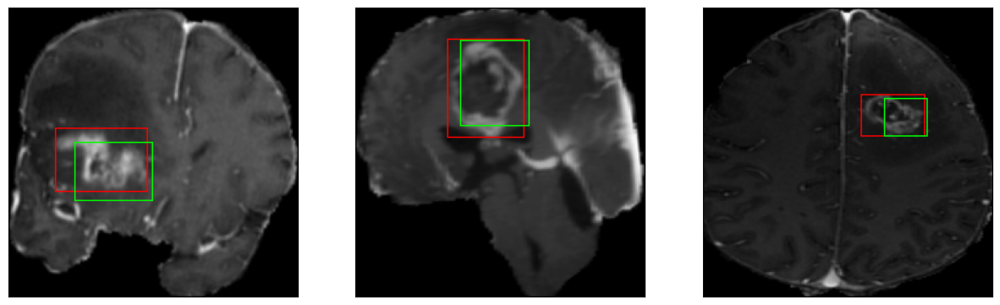

52/52 [==============================] - 19s 374ms/step - loss: 8.7937 - IoU: 0.4485 - val_loss: 10.0307 - val_IoU: 0.4947
Epoch 70/100
52/52 [==============================] - ETA: 0s - loss: 8.7877 - IoU: 0.4473
Epoch 70: val_IoU did not improve from 0.59856
8/8 [==============================] - 1s 142ms/step


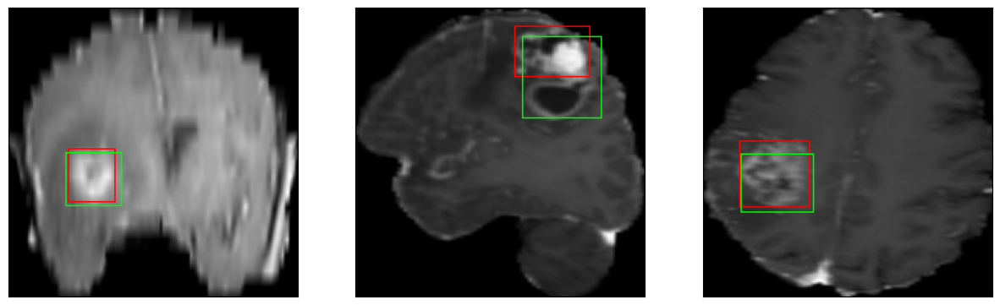

52/52 [==============================] - 19s 368ms/step - loss: 8.7877 - IoU: 0.4473 - val_loss: 9.2962 - val_IoU: 0.5544
Epoch 71/100
52/52 [==============================] - ETA: 0s - loss: 8.7972 - IoU: 0.4528
Epoch 71: val_IoU did not improve from 0.59856
8/8 [==============================] - 1s 141ms/step


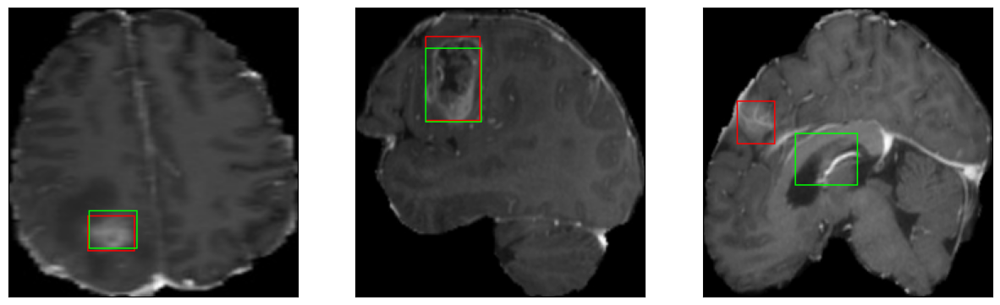

52/52 [==============================] - 19s 371ms/step - loss: 8.7972 - IoU: 0.4528 - val_loss: 9.5088 - val_IoU: 0.5889
Epoch 72/100
52/52 [==============================] - ETA: 0s - loss: 8.9354 - IoU: 0.4490
Epoch 72: val_IoU did not improve from 0.59856
8/8 [==============================] - 1s 143ms/step


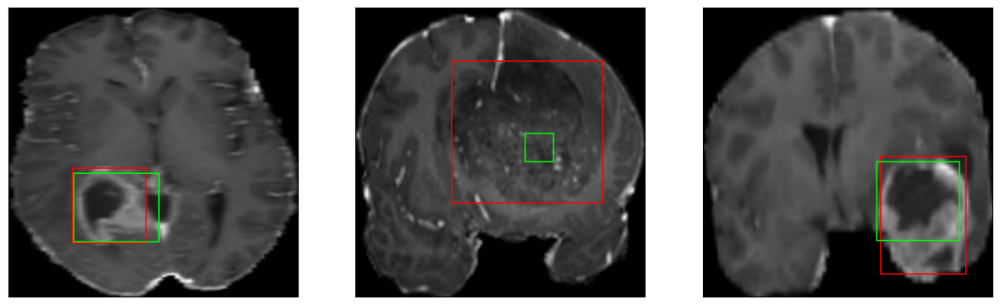

52/52 [==============================] - 19s 374ms/step - loss: 8.9354 - IoU: 0.4490 - val_loss: 9.6976 - val_IoU: 0.5650
Epoch 73/100
52/52 [==============================] - ETA: 0s - loss: 8.8026 - IoU: 0.4549
Epoch 73: val_IoU did not improve from 0.59856
8/8 [==============================] - 1s 143ms/step


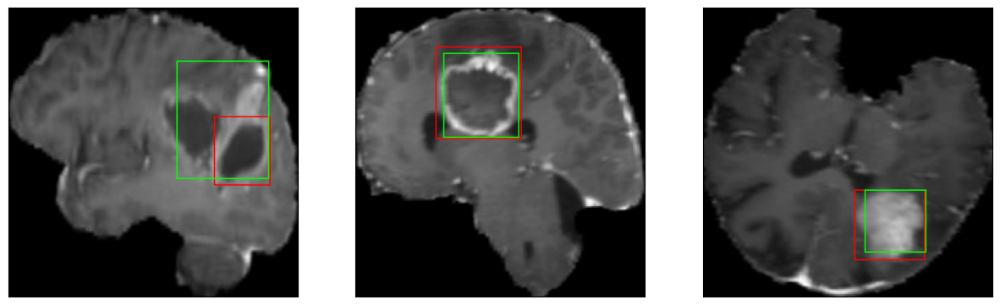

52/52 [==============================] - 19s 372ms/step - loss: 8.8026 - IoU: 0.4549 - val_loss: 9.3339 - val_IoU: 0.5632
Epoch 74/100
52/52 [==============================] - ETA: 0s - loss: 8.9468 - IoU: 0.4441
Epoch 74: val_IoU did not improve from 0.59856
8/8 [==============================] - 1s 143ms/step


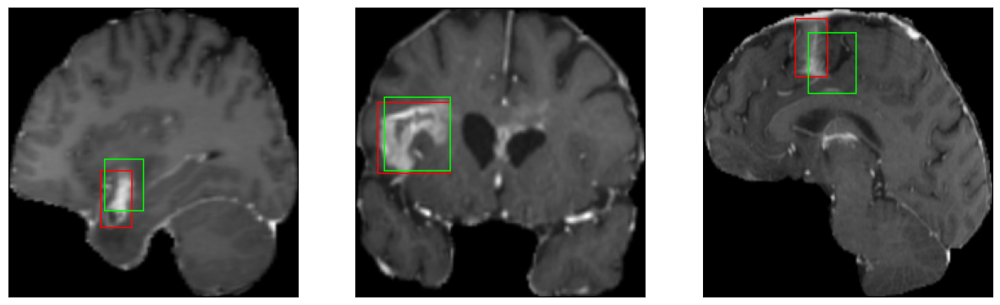

52/52 [==============================] - 19s 373ms/step - loss: 8.9468 - IoU: 0.4441 - val_loss: 11.9207 - val_IoU: 0.4990
Epoch 75/100
52/52 [==============================] - ETA: 0s - loss: 8.9005 - IoU: 0.4520
Epoch 75: val_IoU did not improve from 0.59856
8/8 [==============================] - 1s 143ms/step


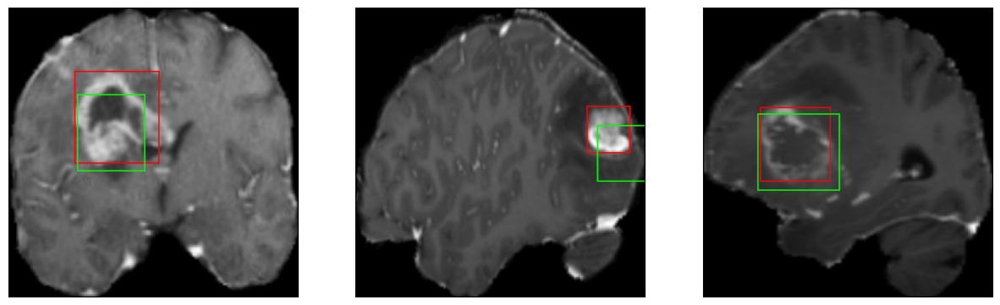

52/52 [==============================] - 20s 377ms/step - loss: 8.9005 - IoU: 0.4520 - val_loss: 10.9303 - val_IoU: 0.4694
Epoch 76/100
52/52 [==============================] - ETA: 0s - loss: 8.8961 - IoU: 0.4488
Epoch 76: val_IoU improved from 0.59856 to 0.60872, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 141ms/step


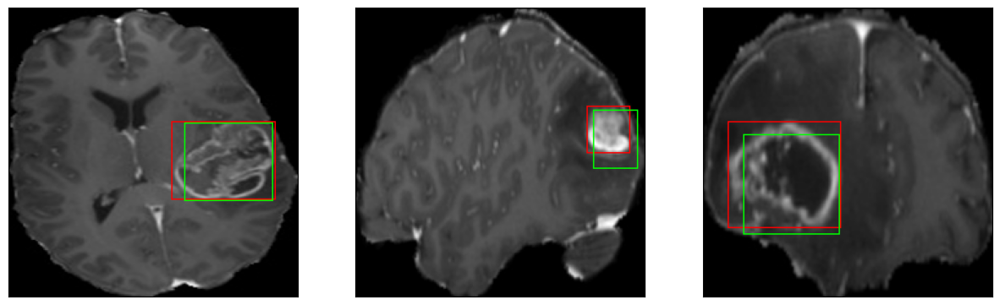

52/52 [==============================] - 29s 566ms/step - loss: 8.8961 - IoU: 0.4488 - val_loss: 8.8510 - val_IoU: 0.6087
Epoch 77/100
52/52 [==============================] - ETA: 0s - loss: 8.8723 - IoU: 0.4504
Epoch 77: val_IoU did not improve from 0.60872
8/8 [==============================] - 1s 144ms/step


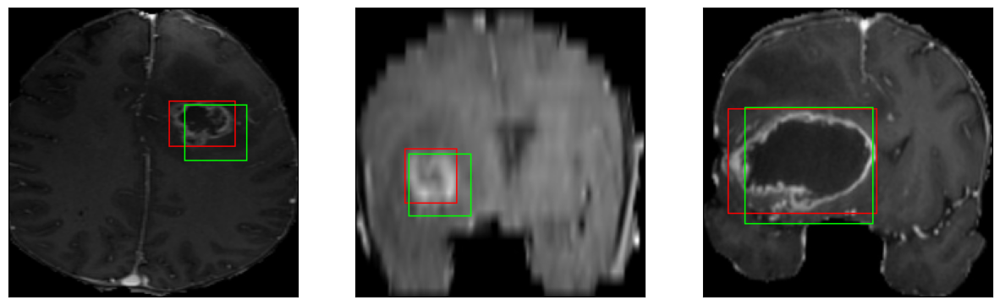

52/52 [==============================] - 19s 369ms/step - loss: 8.8723 - IoU: 0.4504 - val_loss: 10.3320 - val_IoU: 0.4928
Epoch 78/100
52/52 [==============================] - ETA: 0s - loss: 8.7959 - IoU: 0.4479
Epoch 78: val_IoU did not improve from 0.60872
8/8 [==============================] - 1s 142ms/step


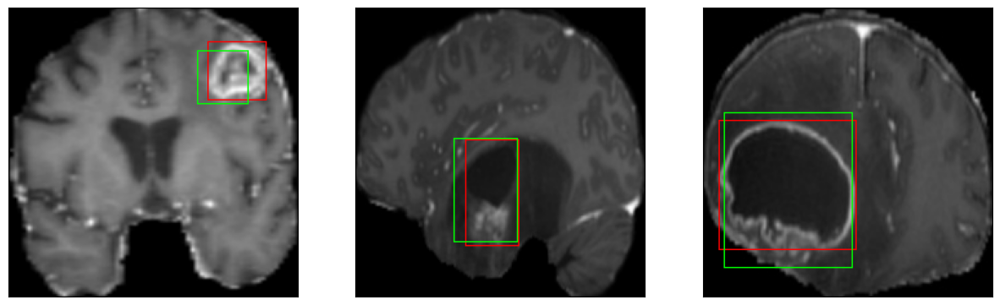

52/52 [==============================] - 20s 376ms/step - loss: 8.7959 - IoU: 0.4479 - val_loss: 8.7792 - val_IoU: 0.5898
Epoch 79/100
52/52 [==============================] - ETA: 0s - loss: 8.8411 - IoU: 0.4469
Epoch 79: val_IoU did not improve from 0.60872
8/8 [==============================] - 1s 142ms/step


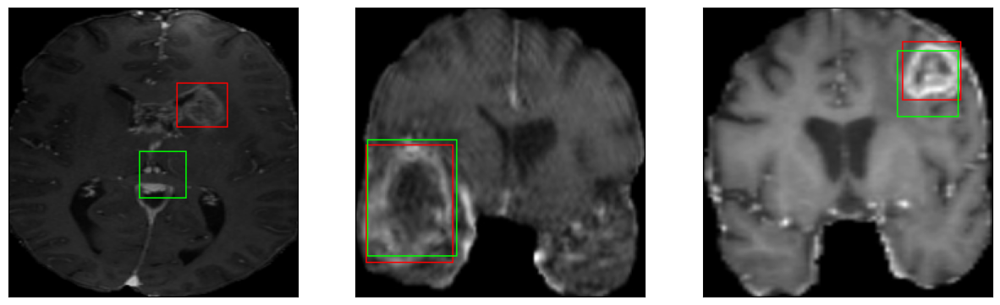

52/52 [==============================] - 19s 373ms/step - loss: 8.8411 - IoU: 0.4469 - val_loss: 8.8776 - val_IoU: 0.5787
Epoch 80/100
52/52 [==============================] - ETA: 0s - loss: 9.1094 - IoU: 0.4455
Epoch 80: val_IoU did not improve from 0.60872
8/8 [==============================] - 1s 142ms/step


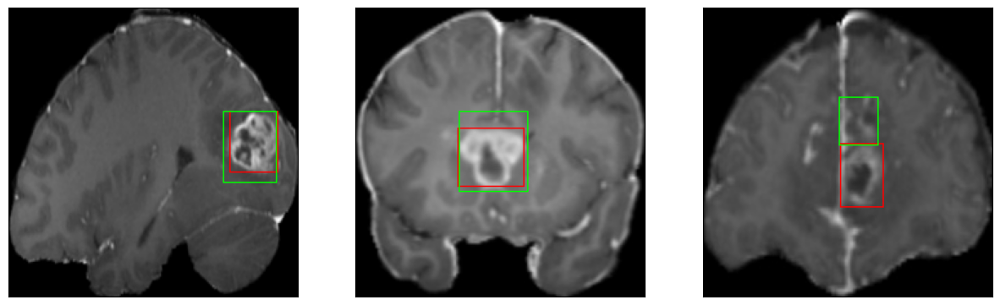

52/52 [==============================] - 19s 375ms/step - loss: 9.1094 - IoU: 0.4455 - val_loss: 18.9433 - val_IoU: 0.3156
Epoch 81/100
52/52 [==============================] - ETA: 0s - loss: 9.2049 - IoU: 0.4366
Epoch 81: val_IoU did not improve from 0.60872
8/8 [==============================] - 1s 143ms/step


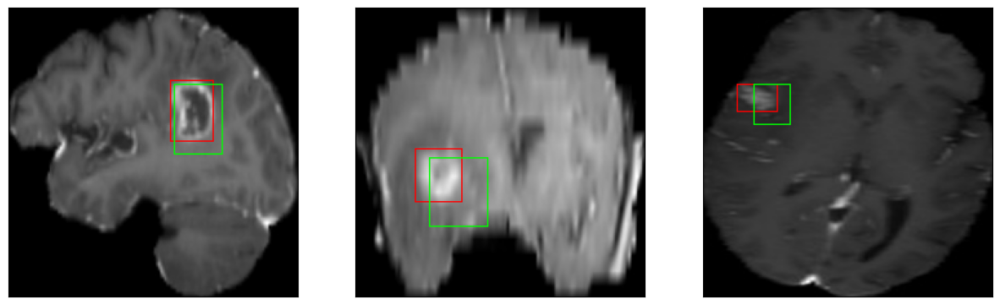

52/52 [==============================] - 19s 371ms/step - loss: 9.2049 - IoU: 0.4366 - val_loss: 12.6551 - val_IoU: 0.4160
Epoch 82/100
52/52 [==============================] - ETA: 0s - loss: 8.9267 - IoU: 0.4570
Epoch 82: val_IoU did not improve from 0.60872
8/8 [==============================] - 1s 141ms/step


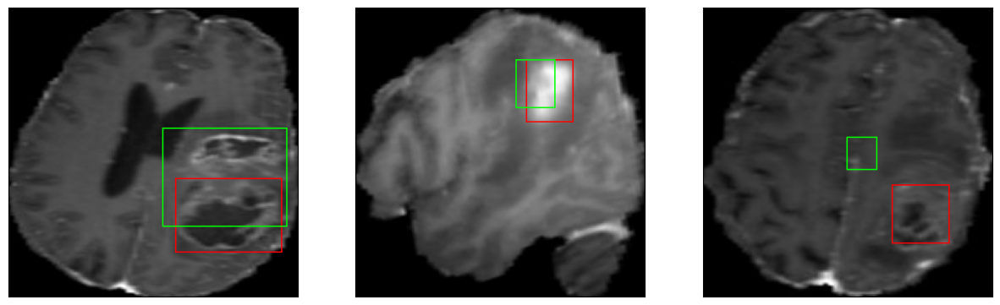

52/52 [==============================] - 19s 373ms/step - loss: 8.9267 - IoU: 0.4570 - val_loss: 10.1452 - val_IoU: 0.5175
Epoch 83/100
52/52 [==============================] - ETA: 0s - loss: 8.9119 - IoU: 0.4451
Epoch 83: val_IoU did not improve from 0.60872
8/8 [==============================] - 1s 141ms/step


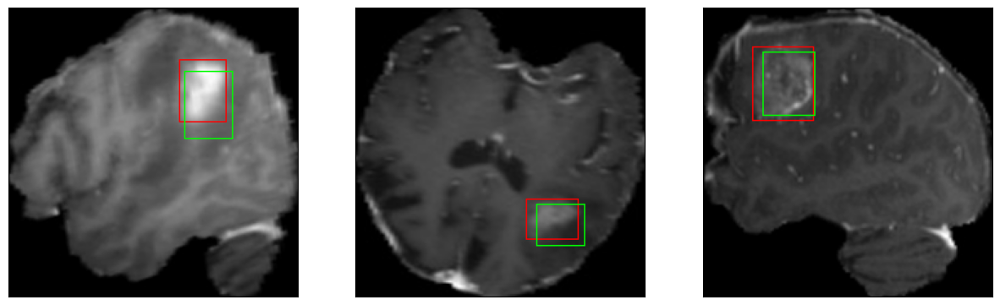

52/52 [==============================] - 19s 374ms/step - loss: 8.9119 - IoU: 0.4451 - val_loss: 10.3221 - val_IoU: 0.5352
Epoch 84/100
52/52 [==============================] - ETA: 0s - loss: 8.8235 - IoU: 0.4512
Epoch 84: val_IoU did not improve from 0.60872
8/8 [==============================] - 1s 143ms/step


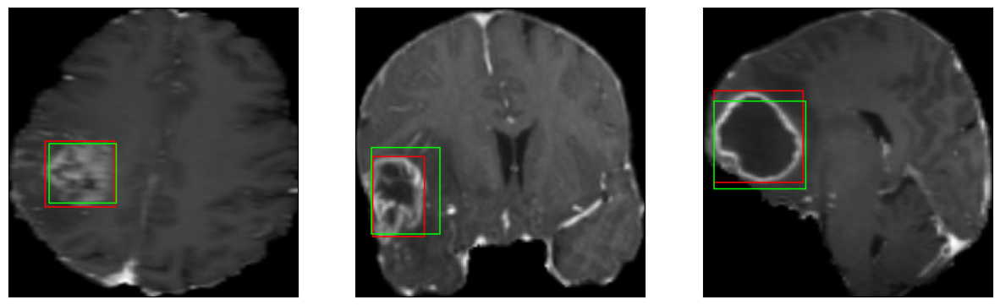

52/52 [==============================] - 20s 382ms/step - loss: 8.8235 - IoU: 0.4512 - val_loss: 8.7645 - val_IoU: 0.5869
Epoch 85/100
52/52 [==============================] - ETA: 0s - loss: 8.5579 - IoU: 0.4571
Epoch 85: val_IoU did not improve from 0.60872
8/8 [==============================] - 1s 140ms/step


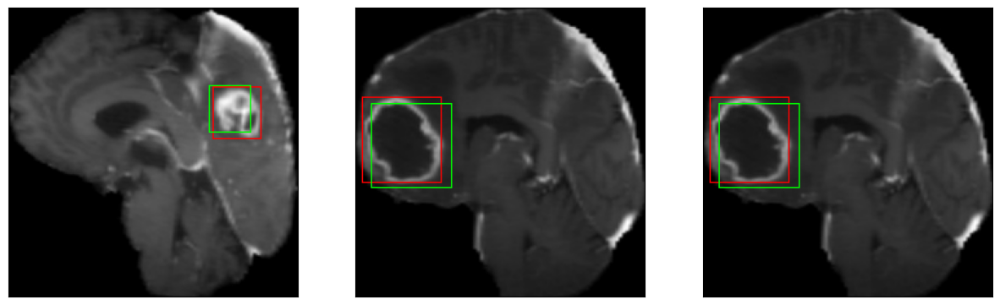

52/52 [==============================] - 20s 378ms/step - loss: 8.5579 - IoU: 0.4571 - val_loss: 8.4591 - val_IoU: 0.5836
Epoch 86/100
52/52 [==============================] - ETA: 0s - loss: 8.8781 - IoU: 0.4460
Epoch 86: val_IoU did not improve from 0.60872
8/8 [==============================] - 1s 142ms/step


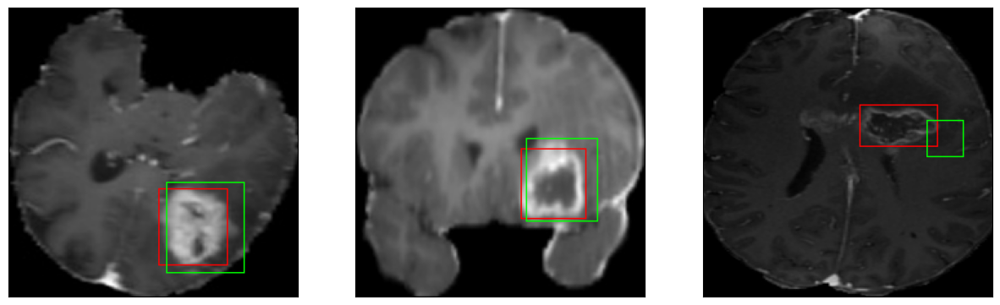

52/52 [==============================] - 19s 375ms/step - loss: 8.8781 - IoU: 0.4460 - val_loss: 9.8749 - val_IoU: 0.4998
Epoch 87/100
52/52 [==============================] - ETA: 0s - loss: 8.7652 - IoU: 0.4515
Epoch 87: val_IoU did not improve from 0.60872
8/8 [==============================] - 1s 141ms/step


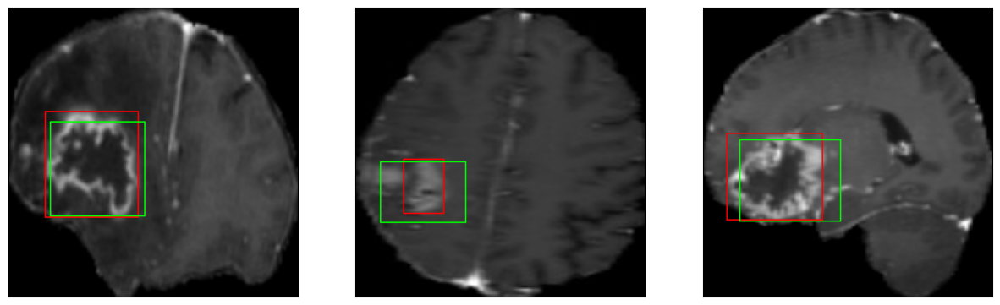

52/52 [==============================] - 19s 371ms/step - loss: 8.7652 - IoU: 0.4515 - val_loss: 10.4977 - val_IoU: 0.4910
Epoch 88/100
52/52 [==============================] - ETA: 0s - loss: 8.7791 - IoU: 0.4563
Epoch 88: val_IoU did not improve from 0.60872
8/8 [==============================] - 1s 145ms/step


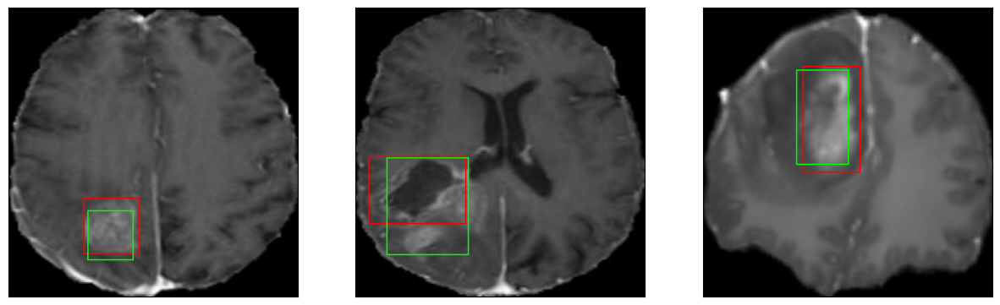

52/52 [==============================] - 19s 373ms/step - loss: 8.7791 - IoU: 0.4563 - val_loss: 10.9252 - val_IoU: 0.5405
Epoch 89/100
52/52 [==============================] - ETA: 0s - loss: 8.6393 - IoU: 0.4583
Epoch 89: val_IoU did not improve from 0.60872
8/8 [==============================] - 1s 141ms/step


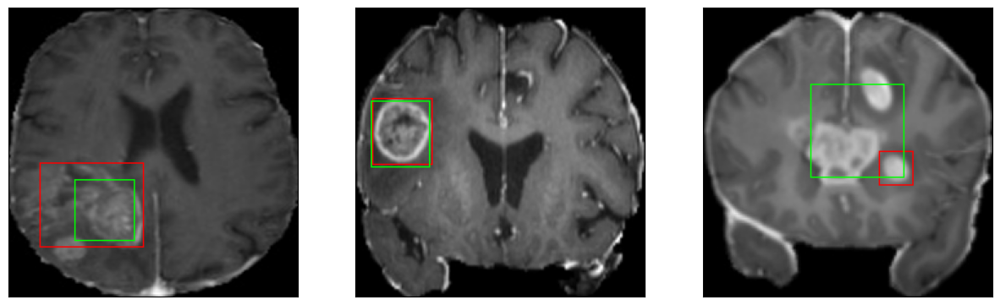

52/52 [==============================] - 19s 376ms/step - loss: 8.6393 - IoU: 0.4583 - val_loss: 8.9301 - val_IoU: 0.5939
Epoch 90/100
52/52 [==============================] - ETA: 0s - loss: 8.5829 - IoU: 0.4552
Epoch 90: val_IoU did not improve from 0.60872
8/8 [==============================] - 1s 143ms/step


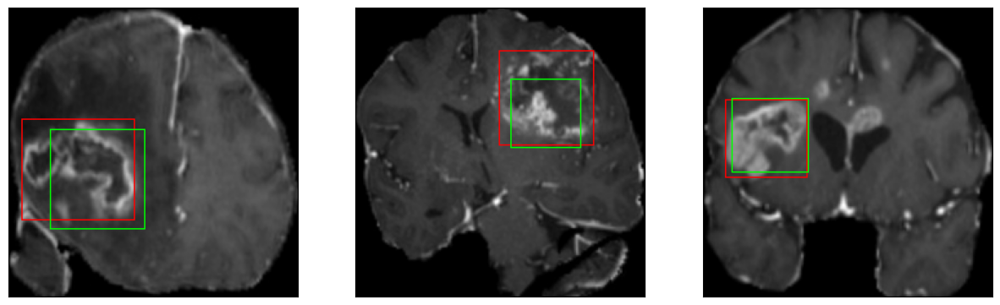

52/52 [==============================] - 19s 369ms/step - loss: 8.5829 - IoU: 0.4552 - val_loss: 9.5675 - val_IoU: 0.5311
Epoch 91/100
52/52 [==============================] - ETA: 0s - loss: 8.8829 - IoU: 0.4514
Epoch 91: val_IoU did not improve from 0.60872
8/8 [==============================] - 1s 141ms/step


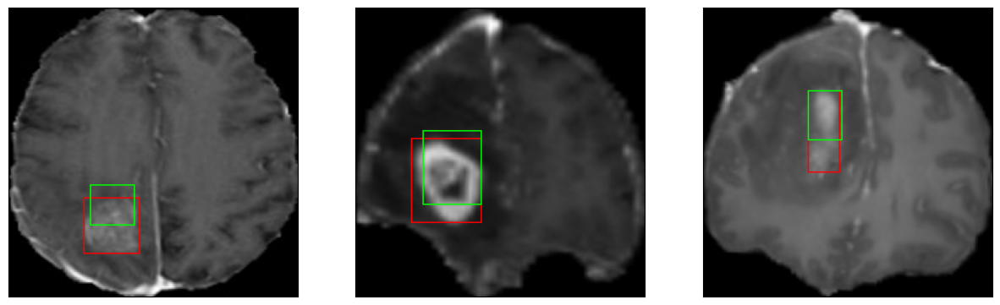

52/52 [==============================] - 19s 374ms/step - loss: 8.8829 - IoU: 0.4514 - val_loss: 9.2022 - val_IoU: 0.5641
Epoch 92/100
52/52 [==============================] - ETA: 0s - loss: 8.7672 - IoU: 0.4460
Epoch 92: val_IoU improved from 0.60872 to 0.61510, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 141ms/step


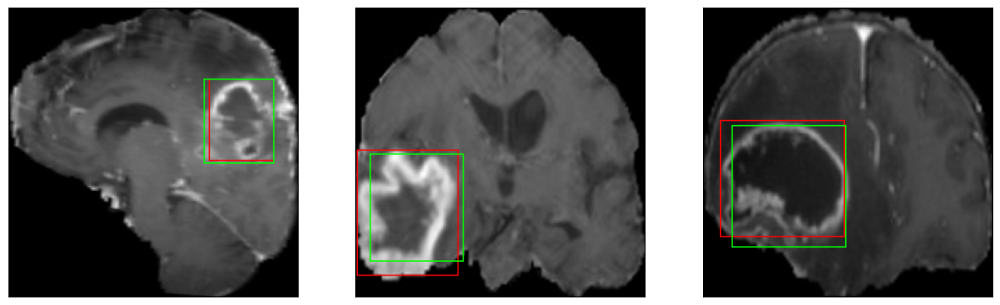

52/52 [==============================] - 40s 786ms/step - loss: 8.7672 - IoU: 0.4460 - val_loss: 8.4468 - val_IoU: 0.6151
Epoch 93/100
52/52 [==============================] - ETA: 0s - loss: 8.3765 - IoU: 0.4697
Epoch 93: val_IoU did not improve from 0.61510
8/8 [==============================] - 1s 144ms/step


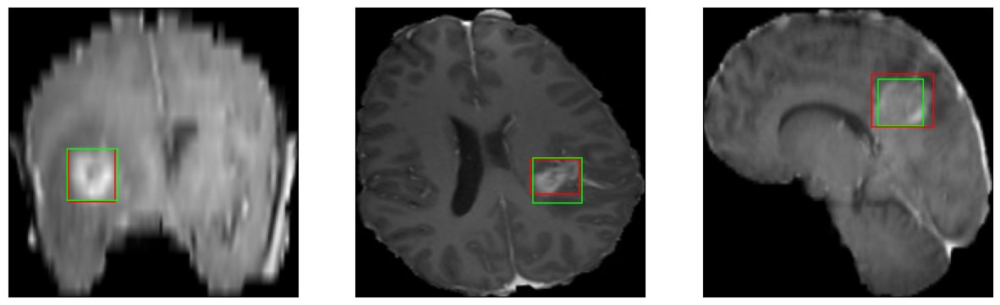

52/52 [==============================] - 20s 386ms/step - loss: 8.3765 - IoU: 0.4697 - val_loss: 8.6717 - val_IoU: 0.6102
Epoch 94/100
52/52 [==============================] - ETA: 0s - loss: 8.7746 - IoU: 0.4500
Epoch 94: val_IoU did not improve from 0.61510
8/8 [==============================] - 1s 143ms/step


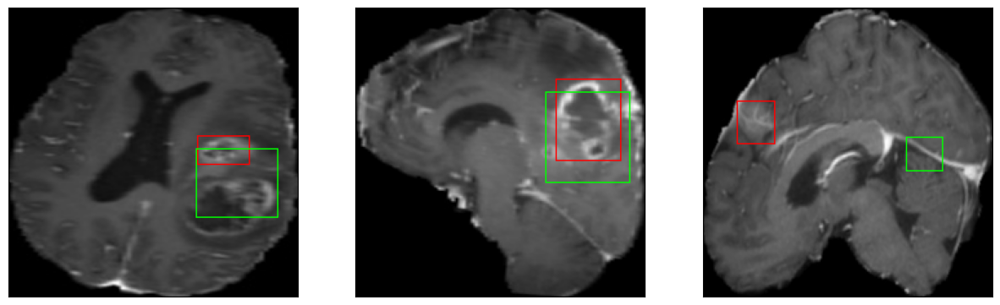

52/52 [==============================] - 20s 382ms/step - loss: 8.7746 - IoU: 0.4500 - val_loss: 9.9045 - val_IoU: 0.5530
Epoch 95/100
52/52 [==============================] - ETA: 0s - loss: 8.6677 - IoU: 0.4591
Epoch 95: val_IoU did not improve from 0.61510
8/8 [==============================] - 1s 144ms/step


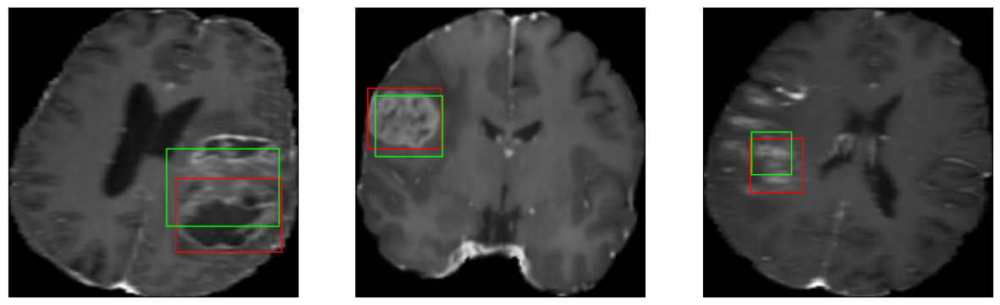

52/52 [==============================] - 19s 376ms/step - loss: 8.6677 - IoU: 0.4591 - val_loss: 8.6453 - val_IoU: 0.5700
Epoch 96/100
52/52 [==============================] - ETA: 0s - loss: 8.5821 - IoU: 0.4551
Epoch 96: val_IoU did not improve from 0.61510
8/8 [==============================] - 1s 142ms/step


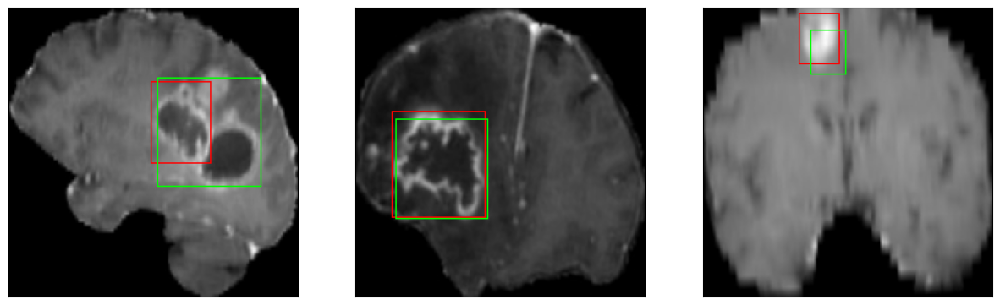

52/52 [==============================] - 19s 375ms/step - loss: 8.5821 - IoU: 0.4551 - val_loss: 8.9586 - val_IoU: 0.5691
Epoch 97/100
52/52 [==============================] - ETA: 0s - loss: 8.0688 - IoU: 0.4802
Epoch 97: val_IoU did not improve from 0.61510
8/8 [==============================] - 1s 141ms/step


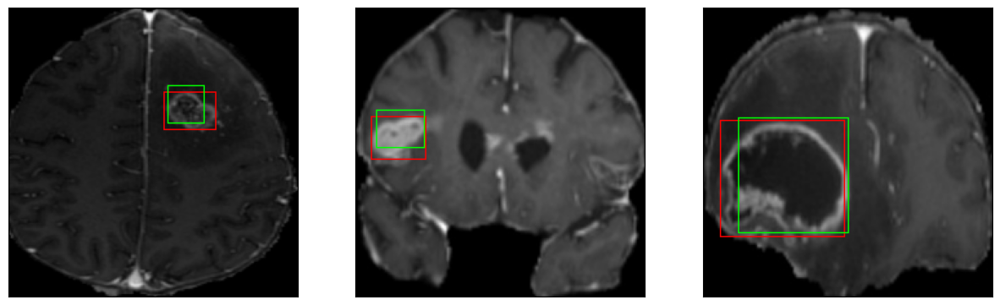

52/52 [==============================] - 19s 375ms/step - loss: 8.0688 - IoU: 0.4802 - val_loss: 8.9657 - val_IoU: 0.5722
Epoch 98/100
52/52 [==============================] - ETA: 0s - loss: 8.8204 - IoU: 0.4491
Epoch 98: val_IoU did not improve from 0.61510
8/8 [==============================] - 1s 142ms/step


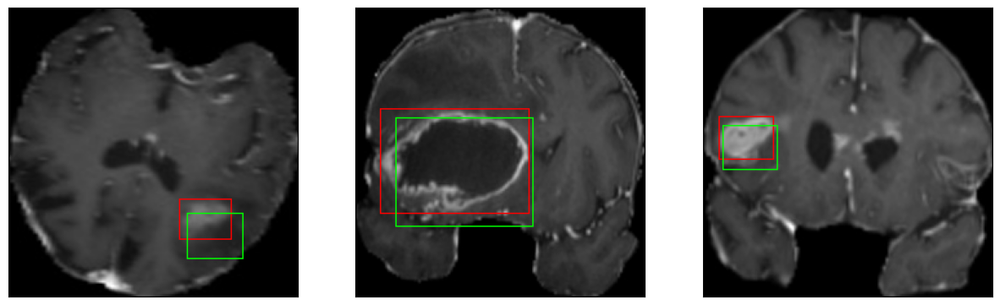

52/52 [==============================] - 20s 379ms/step - loss: 8.8204 - IoU: 0.4491 - val_loss: 9.8275 - val_IoU: 0.5178
Epoch 99/100
52/52 [==============================] - ETA: 0s - loss: 8.6895 - IoU: 0.4511
Epoch 99: val_IoU did not improve from 0.61510
8/8 [==============================] - 1s 146ms/step


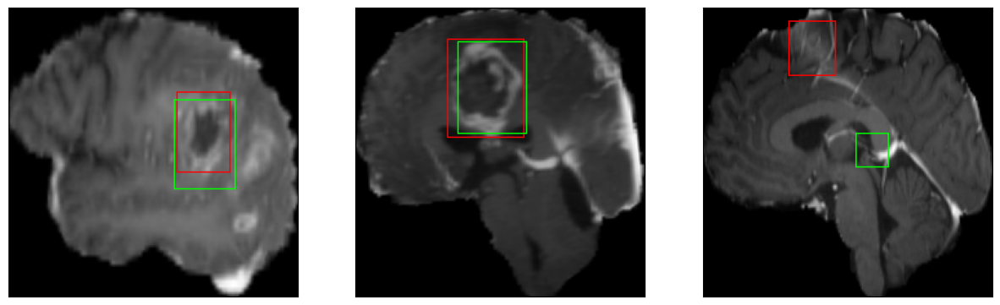

52/52 [==============================] - 20s 378ms/step - loss: 8.6895 - IoU: 0.4511 - val_loss: 8.9406 - val_IoU: 0.5784
Epoch 100/100
52/52 [==============================] - ETA: 0s - loss: 8.7239 - IoU: 0.4490
Epoch 100: val_IoU did not improve from 0.61510
8/8 [==============================] - 1s 143ms/step


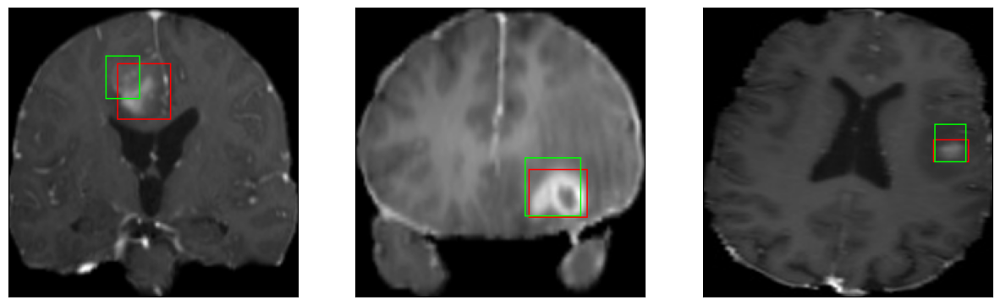

52/52 [==============================] - 20s 378ms/step - loss: 8.7239 - IoU: 0.4490 - val_loss: 11.2159 - val_IoU: 0.4441


In [25]:
hist = model.fit(
        train_dataset,
        epochs=100,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

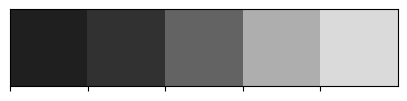

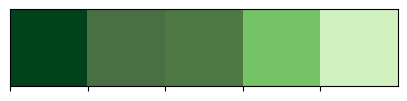

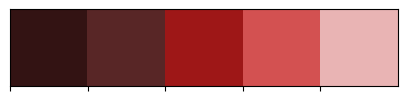

In [26]:
import seaborn as sns
colors_dark = ["#1F1F1F", "#313131", '#636363', '#AEAEAE', '#DADADA']
colors_red = ["#331313", "#582626", '#9E1717', '#D35151', '#E9B4B4']
colors_green = ['#01411C','#4B6F44','#4F7942','#74C365','#D0F0C0']

sns.palplot(colors_dark)
sns.palplot(colors_green)
sns.palplot(colors_red)

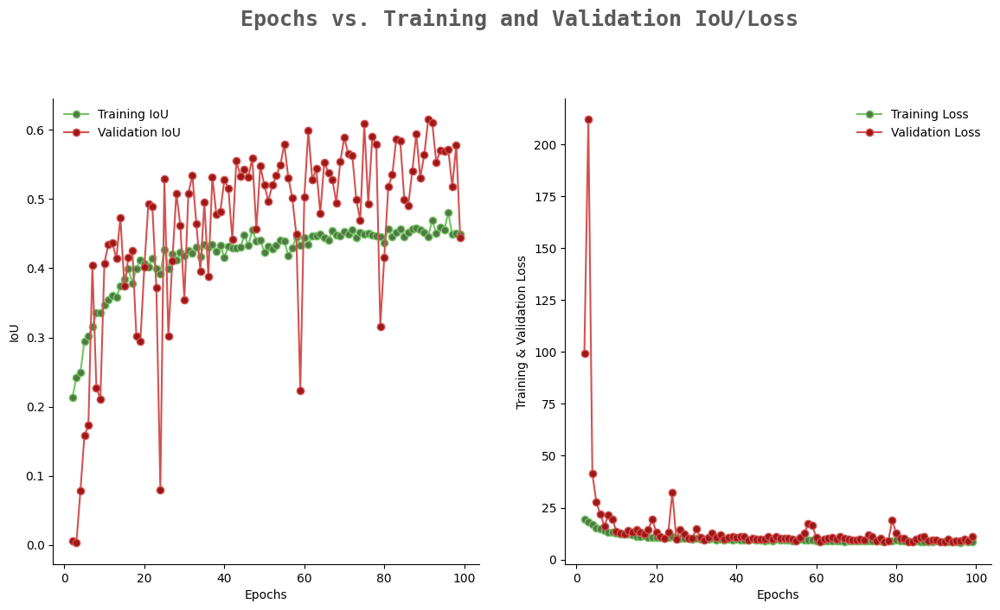

In [46]:
from warnings import filterwarnings
filterwarnings('ignore')

epochs = [i for i in range(2,100)]
fig, ax = plt.subplots(1,2,figsize=(14,7))
train_acc = hist.history['IoU']
train_loss = hist.history['loss']
val_acc = hist.history['val_IoU']
val_loss = hist.history['val_loss']

fig.text(s='Epochs vs. Training and Validation IoU/Loss',size=18,fontweight='bold',
             fontname='monospace',color=colors_dark[1],y=1,x=0.28,alpha=0.8)

sns.despine()
ax[0].plot(epochs, train_acc[2:100], marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label = 'Training IoU')
ax[0].plot(epochs, val_acc[2:100], marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation IoU')
ax[0].legend(frameon=False)
ax[0].set_xlabel('Epochs')
ax[0].set_ylabel('IoU')

sns.despine()
ax[1].plot(epochs, train_loss[2:100], marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label ='Training Loss')
ax[1].plot(epochs, val_loss[2:100], marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation Loss')
ax[1].legend(frameon=False)
ax[1].set_xlabel('Epochs')
ax[1].set_ylabel('Training & Validation Loss')

fig.show()

In [29]:
model = tf.keras.models.load_model('./model_checkpoint_RESNET/model_RESNET.h5', compile=False)

In [30]:
model.compile(
    loss={
        'bb_pred': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
    
)

In [31]:
model.evaluate(test_dataset)

15/15 [==============================] - 4s 86ms/step - loss: 9.4323 - IoU: 0.5590


[9.432293891906738, 0.5590271353721619]

In [32]:
model.evaluate(val_dataset)

6/6 [==============================] - 1s 81ms/step - loss: 8.4468 - IoU: 0.6192


[8.446815490722656, 0.6192147135734558]

In [33]:
model.evaluate(train_dataset)

52/52 [==============================] - 5s 88ms/step - loss: 4.2343 - IoU: 0.7035


[4.234307289123535, 0.7035471200942993]